<img src = "https://raw.githubusercontent.com/barcelonagse-datascience/academic_files/master/images/BSE_DSC_HEADER.jpg">

In [282]:
import pandas as pd
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
import category_encoders as ce
import datetime
import matplotlib.pyplot as plt
from scipy.stats import skew
from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.impute import KNNImputer
import warnings
from category_encoders import TargetEncoder
import seaborn as sns
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import RFECV, SelectKBest, chi2, f_classif
from sklearn.svm import SVC 
from xgboost import XGBRegressor  
import lightgbm as lgb
from sklearn.ensemble import ExtraTreesRegressor, RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor
from sklearn.metrics import mean_squared_error
from mlens.ensemble import SuperLearner, BlendEnsemble, Subsemble, SequentialEnsemble
from sklearn.neighbors import KNeighborsRegressor
from sklearn.cluster import KMeans
import shap
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Activation
from keras.callbacks import EarlyStopping
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from keras import regularizers
from keras.constraints import MaxNorm
from tensorflow.keras import initializers
import mnist
from tensorflow import keras
from tensorflow.keras.optimizers import SGD, RMSprop
from tensorflow.keras.callbacks import ReduceLROnPlateau
warnings.filterwarnings("ignore")


## 1. LOAD DATA

In [2]:
# Training dataset
df_train=pd.read_csv(r'C:\Users\julia\OneDrive\Documentos\DSDM\2nd TERM\Computational Learning\DL_materials\project\dl24-probability-of-death-with-k-nn\mimic_train.csv')

#Extra data
mimic_metadata=pd.read_csv(r'C:\Users\julia\OneDrive\Documentos\DSDM\2nd TERM\Computational Learning\DL_materials\project\dl24-probability-of-death-with-k-nn\MIMIC_metadata_diagnose.csv')
mimic_diagnose=pd.read_csv(r'C:\Users\julia\OneDrive\Documentos\DSDM\2nd TERM\Computational Learning\DL_materials\project\dl24-probability-of-death-with-k-nn\extra_data\MIMIC_diagnoses.csv')

# Test dataset (to produce predictions)
df_test=pd.read_csv(r'C:\Users\julia\OneDrive\Documentos\DSDM\2nd TERM\Computational Learning\DL_materials\project\dl24-probability-of-death-with-k-nn\mimic_test_death.csv')
df_test.sort_values('icustay_id').head()

,subject_id,hadm_id,icustay_id,HeartRate_Min,HeartRate_Max,HeartRate_Mean,SysBP_Min,SysBP_Max,SysBP_Mean,DiasBP_Min,...,ADMITTIME,Diff,ADMISSION_TYPE,INSURANCE,RELIGION,MARITAL_STATUS,ETHNICITY,DIAGNOSIS,ICD9_diagnosis,FIRST_CAREUNIT
4930,93535,121562,200011,56.0,82.0,71.205128,123.0,185.0,156.411765,37.0,...,2188-08-05 20:27:00,-64881.43517,EMERGENCY,Medicare,JEWISH,SINGLE,WHITE,ASTHMA;COPD EXACERBATION,49322,MICU
1052,30375,177945,200044,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,2135-07-07 16:13:00,-46540.62661,EMERGENCY,Medicare,CATHOLIC,WIDOWED,WHITE,HEAD BLEED,85220,SICU
3412,73241,149216,200049,54.0,76.0,64.833333,95.0,167.0,114.545455,33.0,...,2118-08-14 22:27:00,-38956.85890,EMERGENCY,Private,JEWISH,MARRIED,WHITE,HEPATIC ENCEPHALOPATHY,5722,MICU
1725,99052,129142,200063,85.0,102.0,92.560976,91.0,131.0,108.365854,42.0,...,2141-03-09 23:19:00,-47014.25437,EMERGENCY,Medicaid,NOT SPECIFIED,SINGLE,UNKNOWN/NOT SPECIFIED,TYPE A DISSECTION,44101,CSRU
981,51698,190004,200081,82.0,133.0,94.323529,86.0,143.0,111.093750,47.0,...,2142-02-23 06:56:00,-47377.26087,EMERGENCY,Medicare,OTHER,MARRIED,PORTUGUESE,PULMONARY EMBOLISM,41519,CCU


In [3]:
#drop columns in train data that are not in test data
df_train.drop(columns=['DOD', 'DISCHTIME', 'DEATHTIME', 'HOSPITAL_EXPIRE_FLAG'], inplace=True)

## 2. TREAT AND ADD EXTRA DATA 

We observe that mimic_diagnose data has information of different illness that have been detected for each patient in each of their hospitalizations.

We will extract three features from these dataset:
 1)  number of hospitalizations of each patient as logically it may be positively correlated with probability of death.
 2) number of illnesses diagnosed for each hospitalization, for the same reason.
 3) all the codes that have been detected by sequence order in a hospitalization.

Regarding mimic_metadata, we observe it only has descriptions of the codes, so we decide not to use it since it does not any value.

In [4]:
mimic_diagnose.head()

,SUBJECT_ID,HADM_ID,SEQ_NUM,ICD9_CODE
0,256,108811,1.0,53240
1,256,108811,2.0,41071
2,256,108811,3.0,53560
3,256,108811,4.0,40390
4,256,108811,5.0,5859


In [5]:
#1)Count the number of different illnesses that the patient had in each hospitalization
mimic_diagnose_n_diagnoses = mimic_diagnose.groupby('HADM_ID')['ICD9_CODE'].nunique()
mimic_diagnose_n_diagnoses = mimic_diagnose_n_diagnoses.reset_index(name='Number Diagnoses')

#2)Count the number of hospitalizations that a patient had up to the last one registered
mimic_diagnose_n_hosp = mimic_diagnose.groupby('SUBJECT_ID')['HADM_ID'].nunique()
mimic_diagnose_n_hosp=mimic_diagnose_n_hosp.reset_index(name="Num_Hospital_stays")

#3)Pivot the table so that all ICD9 codes of a hospital stay are converted to columns. Those empty will be filled with NA
mimic_update = mimic_diagnose.pivot_table(index=['SUBJECT_ID', 'HADM_ID'], columns='SEQ_NUM', values='ICD9_CODE', aggfunc='first')
mimic_update.columns = [f'ICD9_CODE_{int(col)}' for col in mimic_update.columns]
mimic_update.reset_index(inplace=True)

In [6]:
#1) Merge number of diagnoses to train and test data
df_train=pd.merge(df_train, mimic_diagnose_n_diagnoses, left_on="hadm_id", right_on="HADM_ID", how='left')
df_test=pd.merge(df_test, mimic_diagnose_n_diagnoses, left_on="hadm_id", right_on="HADM_ID", how='left')

In [7]:
#2) Merge number of hospitalizations to train and test data
df_train=pd.merge(df_train, mimic_diagnose_n_hosp, left_on="subject_id", right_on="SUBJECT_ID", how='left')
df_test=pd.merge(df_test, mimic_diagnose_n_hosp, left_on="subject_id", right_on="SUBJECT_ID", how='left')

In [8]:
#3) Merge all diagnoses detected in a hospitalization as columns
df_train = pd.merge(df_train, mimic_update, how='left', left_on=['subject_id', 'hadm_id'], right_on=['SUBJECT_ID', 'HADM_ID'])
df_test = pd.merge(df_test, mimic_update, how='left', left_on=['subject_id', 'hadm_id'], right_on=['SUBJECT_ID', 'HADM_ID'])


In [9]:
#Drop unused variables produced from merges
df_train.drop(columns=['HADM_ID_x','SUBJECT_ID_x','SUBJECT_ID_y', 'HADM_ID_y'], inplace=True, errors='ignore')
df_test.drop(columns=['HADM_ID_x','SUBJECT_ID_x','SUBJECT_ID_y', 'HADM_ID_y'], inplace=True, errors='ignore')

## 3. EDA

We conduct a first exploratory analysis where we mainly do the following:

  1) Check the distribution of numerical continuous variables.
  2) Check the distribution of the target variable
  3) Check for correlation between numerical and categorical variables with the target variable.
  4) Check for missing values and draw conclusions on how to impute them.


In [10]:

# Numerical columns
numerical_columns = df_train.select_dtypes(include=['number']).columns
print("Numerical Columns:", numerical_columns)


# Categorical columns
categorical_columns = df_train.select_dtypes(include=['object']).columns
print("\nCategorical Columns:", categorical_columns)


Numerical Columns: Index(['subject_id', 'hadm_id', 'icustay_id', 'HeartRate_Min', 'HeartRate_Max',
       'HeartRate_Mean', 'SysBP_Min', 'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min',
       'DiasBP_Max', 'DiasBP_Mean', 'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean',
       'RespRate_Min', 'RespRate_Max', 'RespRate_Mean', 'TempC_Min',
       'TempC_Max', 'TempC_Mean', 'SpO2_Min', 'SpO2_Max', 'SpO2_Mean',
       'Glucose_Min', 'Glucose_Max', 'Glucose_Mean', 'Diff', 'LOS',
       'Number Diagnoses', 'Num_Hospital_stays'],
      dtype='object')

Categorical Columns: Index(['GENDER', 'DOB', 'ADMITTIME', 'ADMISSION_TYPE', 'INSURANCE', 'RELIGION',
       'MARITAL_STATUS', 'ETHNICITY', 'DIAGNOSIS', 'ICD9_diagnosis',
       'FIRST_CAREUNIT', 'ICD9_CODE_1', 'ICD9_CODE_2', 'ICD9_CODE_3',
       'ICD9_CODE_4', 'ICD9_CODE_5', 'ICD9_CODE_6', 'ICD9_CODE_7',
       'ICD9_CODE_8', 'ICD9_CODE_9', 'ICD9_CODE_10', 'ICD9_CODE_11',
       'ICD9_CODE_12', 'ICD9_CODE_13', 'ICD9_CODE_14', 'ICD9_CODE_15',
       'ICD9_CO

1. DISTRIBUTION OF NUMERICAL CONTINUOUS

We are going to plot histogram and scatterplots (grouped by target variable) for the numerical continuous variables and draw some conclusions that will be useful to know how preprocessing can be done best.

In [11]:
numerical_continuous=['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'Number Diagnoses', 'Num_Hospital_stays', 'LOS']

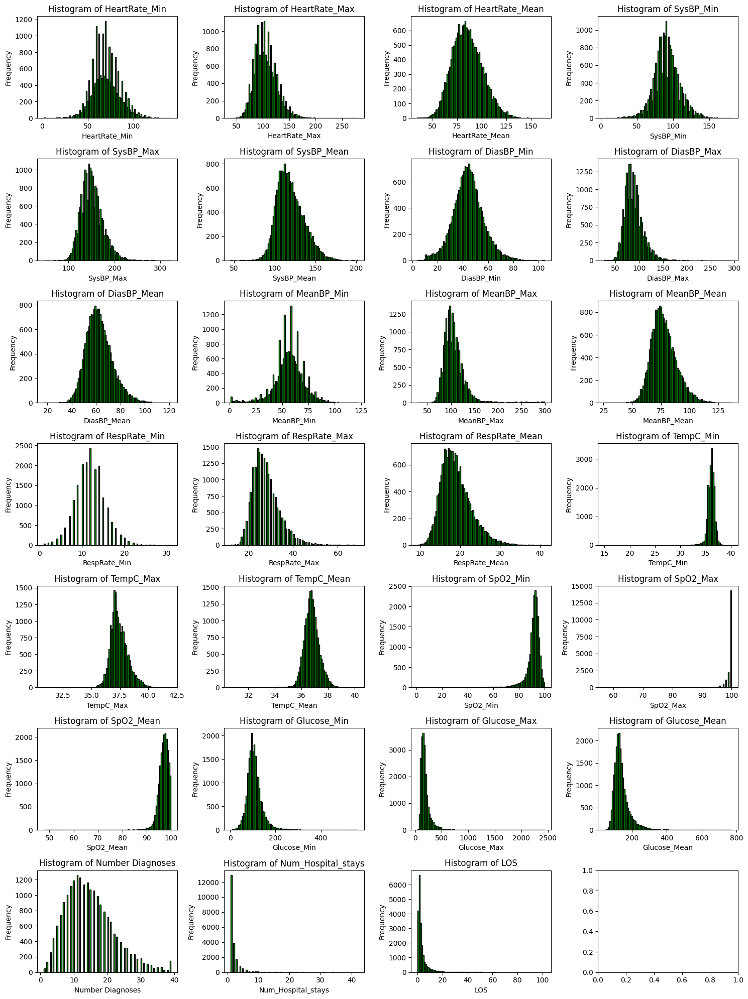

In [12]:
#Create histograms
# Create subplots
fig, axes = plt.subplots(7, 4, figsize=(15, 20))

# Plot histograms for each column
for i, col in enumerate(numerical_continuous):
    row_index = i // 4  # Calculate row index
    col_index = i % 4   # Calculate column index
    
    # Plot histogram
    axes[row_index, col_index].hist(df_train[col], bins=100, color='green', edgecolor='black')
    axes[row_index, col_index].set_xlabel(col)
    axes[row_index, col_index].set_ylabel('Frequency')
    axes[row_index, col_index].set_title(f'Histogram of {col}')  # Use the column name in the title
    axes[row_index, col_index].grid(False)

plt.tight_layout()
plt.show()


Regarding histograms, we observe that most of the variables have a quite right or left skew distribution (and most variables with skewness over 0.5 in absolute value) . This is important to consider the NA imputations method. We will not use the mean since it will be influenced by very extreme values. We will consider other methods such as Iterative Imputer or KNN. Moreover, we will standardize numerical continuous variables using the RobustScaler since it is less sentitive to extreme values.

In [13]:
#Explore skewness of variables
skewness_dict = {}
for col in numerical_continuous:
   
    non_nan_values = df_train[col].dropna()
    my_skew = skew(non_nan_values)
    skewness_dict[col] = my_skew

print(skewness_dict)

{'HeartRate_Min': 0.200556995031067, 'HeartRate_Max': 0.6626257902618486, 'HeartRate_Mean': 0.3321691758462055, 'SysBP_Min': 0.11741878205233441, 'SysBP_Max': 0.7287900519510719, 'SysBP_Mean': 0.5615753130175963, 'DiasBP_Min': 0.19459331562562548, 'DiasBP_Max': 1.2566917571947622, 'DiasBP_Mean': 0.6027731562308959, 'MeanBP_Min': -0.6032107513981734, 'MeanBP_Max': 3.0908221243416136, 'MeanBP_Mean': 0.60664185728801, 'RespRate_Min': 0.25721166837453413, 'RespRate_Max': 1.2444704802684725, 'RespRate_Mean': 0.9284391987933337, 'TempC_Min': -3.0306005842387784, 'TempC_Max': 0.27321937924679623, 'TempC_Mean': -0.4430440227455398, 'SpO2_Min': -5.002709683613277, 'SpO2_Max': -9.697360068576621, 'SpO2_Mean': -4.551716691754743, 'Glucose_Min': 2.0449242032248542, 'Glucose_Max': 4.057819216263687, 'Glucose_Mean': 2.207770188924157, 'Number Diagnoses': 0.767939844304691, 'Num_Hospital_stays': 6.699090417209229, 'LOS': 4.864336358933074}


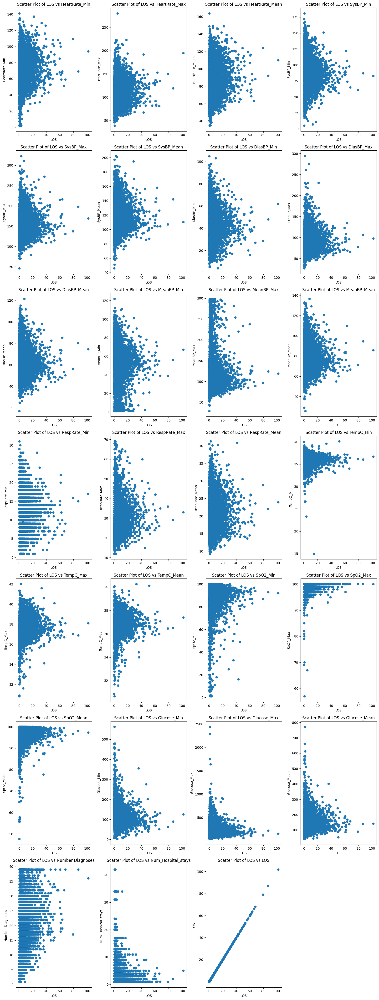

In [14]:
import matplotlib.pyplot as plt

# Define the number of plots per row and the total number of rows
plots_per_row = 4
total_rows = (len(numerical_continuous) + plots_per_row - 1) // plots_per_row

# Create subplots
fig, axes = plt.subplots(total_rows, plots_per_row, figsize=(16, 6 * total_rows))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot scatter plots for each independent variable
for i, indep_var in enumerate(numerical_continuous):
    # Plot scatter plot
    axes[i].scatter(df_train['LOS'], df_train[indep_var])
    
    # Add labels and title
    axes[i].set_xlabel('LOS')
    axes[i].set_ylabel(indep_var)
    axes[i].set_title(f'Scatter Plot of LOS vs {indep_var}')

# Hide empty subplots if the number of variables is not a multiple of plots_per_row
for j in range(len(numerical_continuous), total_rows * plots_per_row):
    axes[j].axis('off')

plt.tight_layout()
plt.show()




We see that in general there are quite many outliers for most of the variables specially when 'LOS' is higher (logical after seeing how skewed are distributions). Therefore, we will not treat them for sure using IQR methods and 
imputing with means (very aggressive in this case). They will not be treated, 
and consider them as part of data distribution.

2. DISTRIBUTION OF TARGET VARIABLE

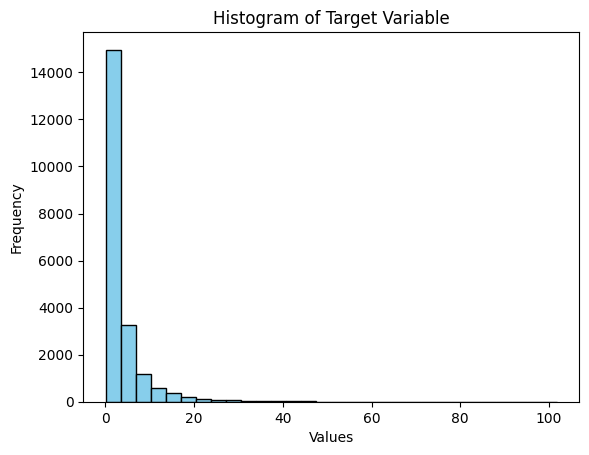

In [15]:
#Distribution of target Variable 'LOS'
import matplotlib.pyplot as plt
import numpy as np


# Create histogram
plt.hist(df_train['LOS'], bins=30, color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Values')
plt.ylabel('Frequency')
plt.title('Histogram of Target Variable')

# Show plot
plt.show()



We observe a quite right-skewed distribution of the variable. We will work with the outcome variable as it is, but maybe working with a log-transformation have helped in predictions. 

3. CORRELATION BETWEEN VARIABLES

In [13]:
numerical_continuous_target=['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'Number Diagnoses', 'Num_Hospital_stays', 'LOS']

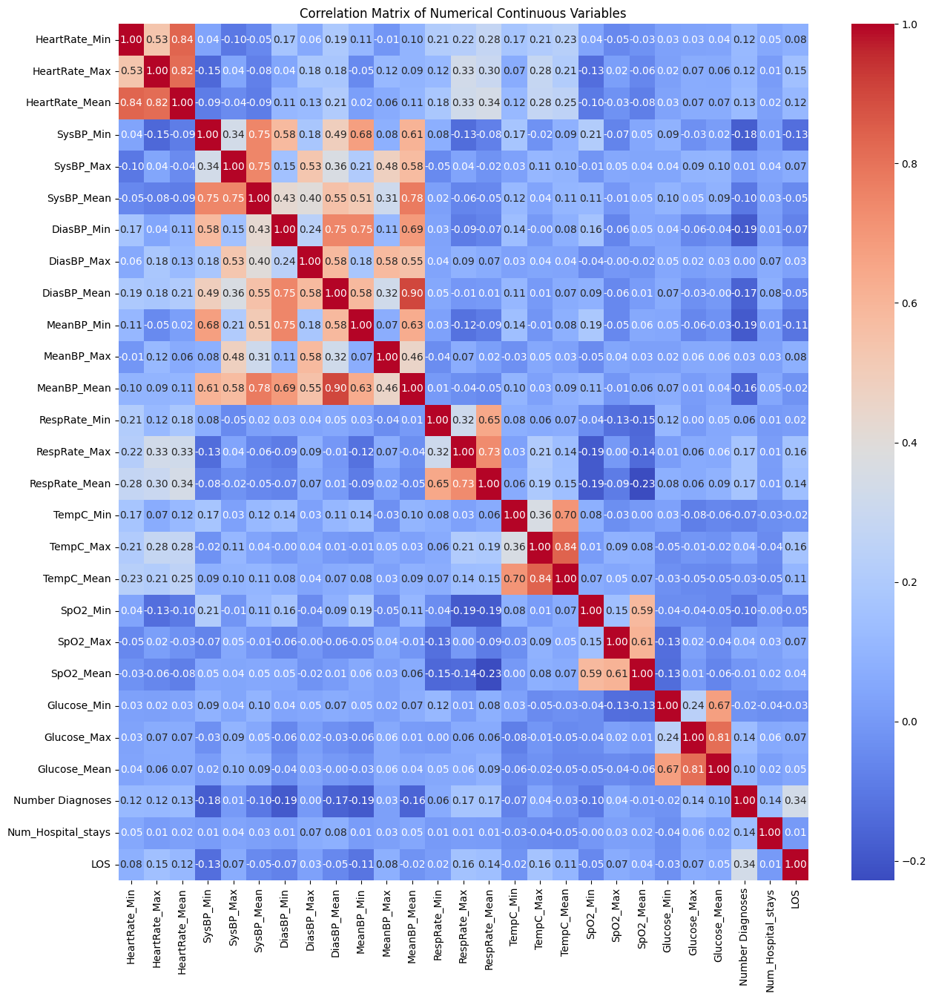

In [78]:
numerical_continuous_df = df_train[numerical_continuous_target]
corr = numerical_continuous_df.corr()
plt.figure(figsize=(15, 15))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Numerical Continuous Variables')
plt.show()

Regarding correlations, we do not observe any particular variable with a stronger correlation with the target variable, except for number of diagnoses (0.34) which seems logic.

Between other numerical variables wee see logical correlation between mean, min and max of the same vital signs which seems logic.Moreover, within SySBP, DiaspBP and Mean BP all related to blood pressure. Given this, we will run the model with kbest selection features to reduce dimensionality and remove redundant features. 

Regarding categorical variables, once we encoded them, we will plot the correlation feature to check for correlation.

4. CHECK MISSING VALUES

We explore quantity of missing values and which variables have them.

In [14]:
missing_percentages = df_train.isnull().sum() / len(df_train) * 100

In [15]:
# Filter missing percentages for columns that start with "ICD9"
icd9_missing_percentages = missing_percentages.loc[missing_percentages.index.str.startswith('ICD9')]

print("Missing percentages for columns starting with 'ICD9':")
print(icd9_missing_percentages.sort_values(ascending=False))
print()

# Filter missing percentages for columns that do not start with "ICD9"
non_icd9_missing_percentages = missing_percentages.loc[~missing_percentages.index.str.startswith('ICD9')]

print("Missing percentages for columns not starting with 'ICD9':")
print(non_icd9_missing_percentages.sort_values(ascending=False))


Missing percentages for columns starting with 'ICD9':
ICD9_CODE_39      99.291357
ICD9_CODE_38      99.142926
ICD9_CODE_37      98.984917
ICD9_CODE_36      98.649749
ICD9_CODE_35      98.362461
ICD9_CODE_34      98.079962
ICD9_CODE_33      97.620302
ICD9_CODE_32      97.084032
ICD9_CODE_31      96.514245
ICD9_CODE_30      95.642806
ICD9_CODE_29      94.804884
ICD9_CODE_28      93.708403
ICD9_CODE_27      92.597558
ICD9_CODE_26      91.089299
ICD9_CODE_25      89.585827
ICD9_CODE_24      87.737611
ICD9_CODE_23      85.539861
ICD9_CODE_22      83.145798
ICD9_CODE_21      80.038305
ICD9_CODE_20      76.610007
ICD9_CODE_19      72.856117
ICD9_CODE_18      68.661719
ICD9_CODE_17      63.931051
ICD9_CODE_16      58.874791
ICD9_CODE_15      53.741920
ICD9_CODE_14      48.182906
ICD9_CODE_13      42.738808
ICD9_CODE_12      36.878142
ICD9_CODE_11      30.854680
ICD9_CODE_10      25.147235
ICD9_CODE_9       19.794111
ICD9_CODE_8       15.015561
ICD9_CODE_7       10.677520
ICD9_CODE_6        7.1

Most of the columns of ICD9_Code will be dropped (NA> 50%) since most of the patients do not have more than 15 diagnoses in a hospitalizations. We  we will Target encode these variables, therefore, we decide to drop those with high percentage of NA not to get the columns filled with more than 50% of values in these columns that are "made up" which will be giving a certain mortality rate to a diagnose that patients did not actually have.

In [16]:
#Drop if any, columns with missing values above 50%
threshold=50
missing_percentages = df_train.isnull().sum() / len(df_train)* 100
columns_to_drop = missing_percentages[missing_percentages >= threshold].index
print(columns_to_drop)

Index(['ICD9_CODE_15', 'ICD9_CODE_16', 'ICD9_CODE_17', 'ICD9_CODE_18',
       'ICD9_CODE_19', 'ICD9_CODE_20', 'ICD9_CODE_21', 'ICD9_CODE_22',
       'ICD9_CODE_23', 'ICD9_CODE_24', 'ICD9_CODE_25', 'ICD9_CODE_26',
       'ICD9_CODE_27', 'ICD9_CODE_28', 'ICD9_CODE_29', 'ICD9_CODE_30',
       'ICD9_CODE_31', 'ICD9_CODE_32', 'ICD9_CODE_33', 'ICD9_CODE_34',
       'ICD9_CODE_35', 'ICD9_CODE_36', 'ICD9_CODE_37', 'ICD9_CODE_38',
       'ICD9_CODE_39'],
      dtype='object')


In [17]:
# Drop the columns from the concatenated DataFrame
df_train.drop(columns_to_drop, axis=1, inplace=True)

In [18]:
df_test.drop(columns_to_drop, axis=1, inplace=True)

Regarding the missing values of the rest of vital signs, we see most of them happen within the same observation. That is, one observation of a hospitalization of a subject ID might have all the vital signs empty. This makes difficult to impute NA with non-linear methods such as KNN given that those observations have not other vital signs, so it is difficult to find 'good neighbors' assuming that probably, vital signs are more reliably predictive of missing vital signs than categorical variables such as Marital status.
This has been prooved empirically, trying KNN does not give as good results as Iterative Imputer.

Regarding the only categorical variable with missing values (MARITAL STATUS), NA will be imputed to the category of UNKNOWN.

## 4. PREPROCESSING OF CATEGORICAL VARIABLES 

We see most of the categorical variables have many different categories so we will try group them in fewer groups and then do either OneHot Econding or Binary Encoding for high cardinality features, not to add too many columns.

A) ENCODING RELIGION

In [19]:
df_train['RELIGION'].value_counts()

RELIGION
CATHOLIC                  7655
NOT SPECIFIED             5398
PROTESTANT QUAKER         2753
JEWISH                    1840
UNOBTAINABLE              1515
OTHER                      702
EPISCOPALIAN               288
GREEK ORTHODOX             178
CHRISTIAN SCIENTIST        164
BUDDHIST                   109
MUSLIM                      74
UNITARIAN-UNIVERSALIST      54
JEHOVAH'S WITNESS           45
ROMANIAN EAST. ORTH         41
HINDU                       38
7TH DAY ADVENTIST           30
HEBREW                       1
Name: count, dtype: int64

In [20]:
#Group Different religion categories in only 4 based on main groups observed
def encode_religion(religion):
    if "CATHOLIC" in religion:
        return "CATHOLIC"
    elif "PROTESTANT" in religion:
        return "PROTESTANT"
    elif "JEWISH" in religion:
        return "JEWISH"
    elif "MUSLIM" in religion:
        return "MUSLIM"
    else:
        return "OTHER"

df_train['RELIGION_TO_ENCODE'] = df_train['RELIGION'].apply(encode_religion)
df_test['RELIGION_TO_ENCODE'] = df_test['RELIGION'].apply(encode_religion)

B) ENCODING MARITAL STATUS

In [21]:
df_train['MARITAL_STATUS'].value_counts()

MARITAL_STATUS
MARRIED              9664
SINGLE               5910
WIDOWED              2819
DIVORCED             1413
SEPARATED             240
UNKNOWN (DEFAULT)     103
LIFE PARTNER           14
Name: count, dtype: int64

In [22]:
#Fill NA with Unknown category given that it is alredy present
df_train['MARITAL_STATUS']=df_train['MARITAL_STATUS'].fillna("UNKNOWN (DEFAULT)")
df_test['MARITAL_STATUS']=df_test['MARITAL_STATUS'].fillna("UNKNOWN (DEFAULT)")

In [23]:
#Group similar categories into one
def encode_marital_status(status):
    if "LIFE PARTNER" in status:
        return "MARRIED"
    elif "DIVORCED" in status:
        return "SEPARATED"
    else:
        return status

df_train['MARITAL_STATUS_TO_ENCODE'] = df_train['MARITAL_STATUS'].apply(encode_marital_status)
df_test['MARITAL_STATUS_TO_ENCODE'] = df_test['MARITAL_STATUS'].apply(encode_marital_status)


C) ENCODING ETHNICITY

In [24]:
df_train['ETHNICITY'].value_counts()

ETHNICITY
WHITE                                                       15112
BLACK/AFRICAN AMERICAN                                       1977
UNABLE TO OBTAIN                                              577
UNKNOWN/NOT SPECIFIED                                         568
HISPANIC OR LATINO                                            562
OTHER                                                         489
ASIAN                                                         265
PATIENT DECLINED TO ANSWER                                    175
HISPANIC/LATINO - PUERTO RICAN                                155
ASIAN - CHINESE                                               146
BLACK/CAPE VERDEAN                                            126
WHITE - RUSSIAN                                               117
BLACK/HAITIAN                                                  72
HISPANIC/LATINO - DOMINICAN                                    59
ASIAN - ASIAN INDIAN                                           58


In [25]:
#Group ethnicity into principal groups according to observed categories and group minorities into "OTHER"
def encode_ethnicity(ethnicity):
    if "WHITE" in ethnicity:
        return "WHITE"
    elif "HISPANIC" in ethnicity:
        return "HISPANIC/LATINO"
    elif "ASIAN" in ethnicity:
        return "ASIAN"
    elif "BLACK" in ethnicity:
        return "BLACK"
    else:
        return "OTHER"

df_train['ETHNICITY_TO_ENCODE'] = df_train['ETHNICITY'].apply(encode_ethnicity)
df_test['ETHNICITY_TO_ENCODE'] = df_test['ETHNICITY'].apply(encode_ethnicity)


D) GENDER, FIRST CAREUNIT AND ADMISSION TYPE

In [26]:
df_train['GENDER'].value_counts()

GENDER
M    11759
F     9126
Name: count, dtype: int64

In [27]:
df_train['FIRST_CAREUNIT'].value_counts()

FIRST_CAREUNIT
MICU     8640
SICU     3961
CSRU     3127
TSICU    2645
CCU      2512
Name: count, dtype: int64

In [28]:
#ADMISSION TYPE
df_train['ADMISSION_TYPE'].value_counts()

ADMISSION_TYPE
EMERGENCY    17817
ELECTIVE      2848
URGENT         220
Name: count, dtype: int64

These three last variables are not considered to be grouped because of its relatively low cardinality and with no redundant groups.

Once categorical have been encoded into fewer groups, they will be one hot or binary encoded. Admission type and Gender are one hote encoded given the few categories. The rest will be encoded using binary encoding not to get too many additional columns.

ONE HOT ENCODING OF ADMISSION TYPE AND GENDER

In [29]:
encoder_OHE = ce.OneHotEncoder(cols=['ADMISSION_TYPE', 'GENDER'],return_df=True)
df_train=encoder_OHE.fit_transform(df_train)
df_test=encoder_OHE.fit_transform(df_test)

BINARY ENCODING OF MARITAL STATUS, ETHNICITY, RELIGION, INSURANCE AND FIRST CARE UNIT

In [30]:
encoder_binary = ce.BinaryEncoder(cols=['MARITAL_STATUS_TO_ENCODE', 'ETHNICITY_TO_ENCODE', 'RELIGION_TO_ENCODE', 'INSURANCE', 'FIRST_CAREUNIT'],return_df=True)
df_train=encoder_binary.fit_transform(df_train)
df_test=encoder_binary.fit_transform(df_test)

We drop the initial variables that have been encoded plus DIAGNOSIS given that this variable it is just the name of the diagnosis and do not give any value added.

In [31]:
#Drop the initial variables that have been encoded plus 'Diagnosis'
df_train=df_train.drop(columns=['RELIGION', 'MARITAL_STATUS', 'ETHNICITY', 'DIAGNOSIS'])
df_test=df_test.drop(columns=['RELIGION', 'MARITAL_STATUS', 'ETHNICITY', 'DIAGNOSIS'])

E) AGE

Given that we have Date of Birth and Admission time, using DIFF col, Age of Admission is computed and will be used as a variable to include in the model.

A function is used to convert input variables to date format. Year of Admission and Year of Birth are computed, and the new variable "Age of Admission", equal to the difference of the latter, is added.

In [32]:

def calculate_age(df, admit_col, dob_col, diff_col):
    df[admit_col] = pd.to_datetime(df[admit_col]) 
    df[dob_col] = pd.to_datetime(df[dob_col])
    df['Diff'] = pd.to_timedelta(df[diff_col], unit='D')

    # Calculate Year of Admission
    df[admit_col] = df[admit_col] + df['Diff']
    df[admit_col] = df[admit_col].dt.year

    # Calculate Year of Birth
    df[dob_col] = df[dob_col] + df['Diff']
    df[dob_col] = df[dob_col].dt.year

    # Calculate Age of Patient on AdmissionDate
    df['Age_Admission'] = df[admit_col] - df[dob_col]

    return df

In [33]:
#Apply function to df_train
df = calculate_age(df_train, 'ADMITTIME', 'DOB', 'Diff')
df_train=df

In [34]:
#Apply function to df_test
df = calculate_age(df_test, 'ADMITTIME', 'DOB', 'Diff')
df_test=df

We check the distribution of Age Related variables to explore this new feature and we see that there are some outliers that have a date of birth in 1700, probably wrong.

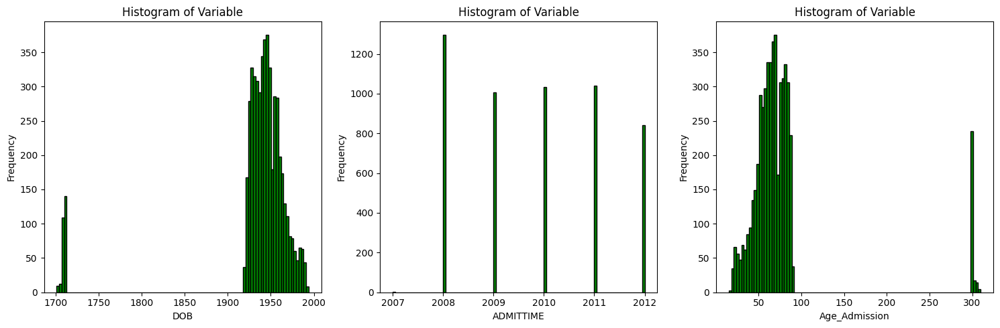

In [38]:
age_related_columns=['DOB', 'ADMITTIME', 'Age_Admission']
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

for i, col in enumerate(age_related_columns):   
    axes[i].hist(df_test[col], bins=100, color='green', edgecolor='black')  
    axes[i].set_xlabel(col)
    axes[i].set_ylabel('Frequency')
    axes[i].set_title('Histogram of Variable')
    axes[i].grid(False)
    
plt.tight_layout()
plt.show()

It seems like observations that have an unusual DOB are the same with resulting unusual AGE Admission but we check if these are the same and do not come from "Diff" variable.

In [35]:
#Define outliers for DOB
old_people_test=df_test[(df_test['DOB']<1900)]
old_people_train=df_train[(df_train['DOB']<1900)]

#Define outliers for Age_Admission
old_age_admission_test=df_test[(df_test['Age_Admission']>150)]
old_age_admission_train=df_train[(df_train['Age_Admission']>150)]

# Extracting Subject IDs from each case
ids_old_people_test = set(old_people_test['subject_id'])
ids_old_people_train = set(old_people_train['subject_id'])
ids_old_age_admission_test = set(old_age_admission_test['subject_id'])
ids_old_age_admission_train = set(old_age_admission_train['subject_id'])

# Checking whether Subject IDs are the same between DataFrames
if (ids_old_people_test == ids_old_age_admission_test) & (ids_old_people_train == ids_old_age_admission_train):
    print("Subject IDs are the same in all DataFrames.")
else:
    print("Subject IDs are not the same in all DataFrames.")


Subject IDs are the same in all DataFrames.


Since these are the same, we treat directly Age of Admission to correct for these irregularities. In Github it is said that in the mimic dataset II, patients with an Age of Admission above 89 have been given a random DOB for privacy issues. Therefore, these outliers will be assigned a random Age of Admission between 90 and 101, for example, which seems a reasonable max range of Hospital Admission.
If this information hadn't been available, the outliers would have been imputed adding to their DOB, the average difference of DOB between outliers and non outliers from df_train.

In [36]:
#Define outliers
outliers_train = df_train['Age_Admission'] > 100
outliers_test = df_test['Age_Admission'] > 100

#Impute with a random number between 90 and 101 to both train and test
imputed_values_train = np.random.randint(90, 101, size=outliers_train.sum())
df_train.loc[outliers_train, 'Age_Admission'] = imputed_values_train

imputed_values_test = np.random.randint(90, 101, size=outliers_test.sum())
df_test.loc[outliers_test, 'Age_Admission'] = imputed_values_test

The histogram for Age of Admission is plotted again to check for correct imputation of these outliers.

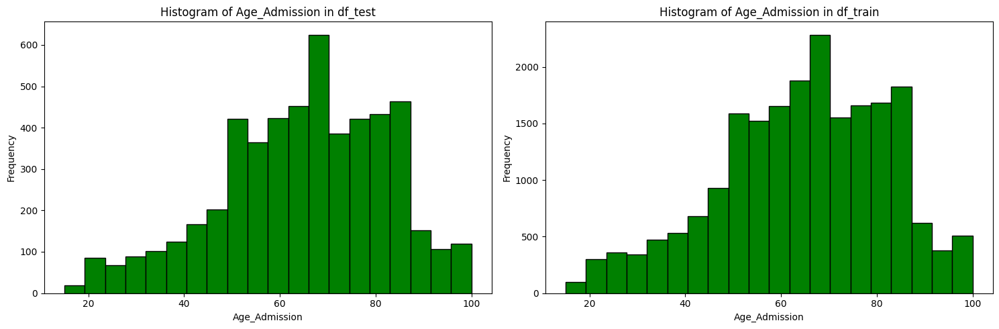

In [41]:
# Create the plots
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Plot for df_test
axes[0].hist(df_test['Age_Admission'], bins=20, color='green', edgecolor='black')
axes[0].set_xlabel('Age_Admission')
axes[0].set_ylabel('Frequency')
axes[0].set_title('Histogram of Age_Admission in df_test')
axes[0].grid(False)

# Plot for df_train
axes[1].hist(df_train['Age_Admission'], bins=20, color='green', edgecolor='black')
axes[1].set_xlabel('Age_Admission')
axes[1].set_ylabel('Frequency')
axes[1].set_title('Histogram of Age_Admission in df_train')
axes[1].grid(False)

plt.tight_layout()
plt.show()

In [37]:
#Drop initial age-related variables
df_train=df_train.drop(columns=['ADMITTIME', 'Diff', 'DOB'])
df_test=df_test.drop(columns=['ADMITTIME', 'Diff', 'DOB'])

F) ICD9 DIAGNOSIS

Regarding the ICD9 diagnosis variable, it will be target encoded based on the Hospital Expire Flag, that is, 
imputing the mean of mortality of that code in each sequence. 

A small smoothing value directs encoding towards the overall mean of the target variable which in this case it is small so it will not allow more specific relationships between diagnose and death to arise. However a large smoothing parameter will produce overfitting. If there is only one observation of a diagnose, it will have a mean of 1 or 0, but it might not be reliably extrapolable to other out of sample.

Cross Validation have not been carried out to determine the optimal parameter but the parameter has been chosen out of trial/error ensuring that in sample roc_auc was similar to out of sample roc_auc(Kaggle). After some trials, parameter 10 seems to work well.


In [38]:
#Drop variable from initial dataset which is equivalent to the first column added from extra data
df_train=df_train.drop(columns=['ICD9_diagnosis'])
df_test=df_test.drop(columns=['ICD9_diagnosis'])

In [39]:
#Initialize Target Encoder
ICD9_encoder = TargetEncoder(smoothing=10)

In [40]:
#Fit Encoder to df_train and transform df_test with same encoder
for col in df_train.columns:
    if col.startswith('ICD9_'):
        df_train[f'{col}_encoded'] = ICD9_encoder.fit_transform(df_train[col], df_train['LOS'])
        df_test[f'{col}_encoded'] = ICD9_encoder.transform(df_test[col])

In [41]:
#Drop initial variables
df_train=df_train.drop(columns=['ICD9_CODE_1', 'ICD9_CODE_2', 'ICD9_CODE_3', 'ICD9_CODE_4',
       'ICD9_CODE_5', 'ICD9_CODE_6', 'ICD9_CODE_7', 'ICD9_CODE_8',
       'ICD9_CODE_9', 'ICD9_CODE_10', 'ICD9_CODE_11', 'ICD9_CODE_12',
       'ICD9_CODE_13', 'ICD9_CODE_14'])
df_test=df_test.drop(columns=['ICD9_CODE_1', 'ICD9_CODE_2', 'ICD9_CODE_3', 'ICD9_CODE_4',
       'ICD9_CODE_5', 'ICD9_CODE_6', 'ICD9_CODE_7', 'ICD9_CODE_8',
       'ICD9_CODE_9', 'ICD9_CODE_10', 'ICD9_CODE_11', 'ICD9_CODE_12',
       'ICD9_CODE_13', 'ICD9_CODE_14'])

G) EXPLORE CORRELATION BETWEEN CATEGORICAL VARIABLES

In [42]:
cat_variables=['GENDER_1', 'GENDER_2', 'ADMISSION_TYPE_1',
       'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3', 'INSURANCE_0', 'INSURANCE_1',
       'INSURANCE_2', 'FIRST_CAREUNIT_0', 'FIRST_CAREUNIT_1',
       'FIRST_CAREUNIT_2',
       'RELIGION_TO_ENCODE_0',
       'RELIGION_TO_ENCODE_1', 'RELIGION_TO_ENCODE_2',
       'MARITAL_STATUS_TO_ENCODE_0', 'MARITAL_STATUS_TO_ENCODE_1',
       'MARITAL_STATUS_TO_ENCODE_2', 'ETHNICITY_TO_ENCODE_0',
       'ETHNICITY_TO_ENCODE_1', 'ETHNICITY_TO_ENCODE_2',
       'ICD9_CODE_1_encoded', 'ICD9_CODE_2_encoded', 'ICD9_CODE_3_encoded',
       'ICD9_CODE_4_encoded', 'ICD9_CODE_5_encoded', 'ICD9_CODE_6_encoded',
       'ICD9_CODE_7_encoded', 'ICD9_CODE_8_encoded', 'ICD9_CODE_9_encoded',
       'ICD9_CODE_10_encoded', 'ICD9_CODE_11_encoded', 'ICD9_CODE_12_encoded',
       'ICD9_CODE_13_encoded', 'ICD9_CODE_14_encoded']

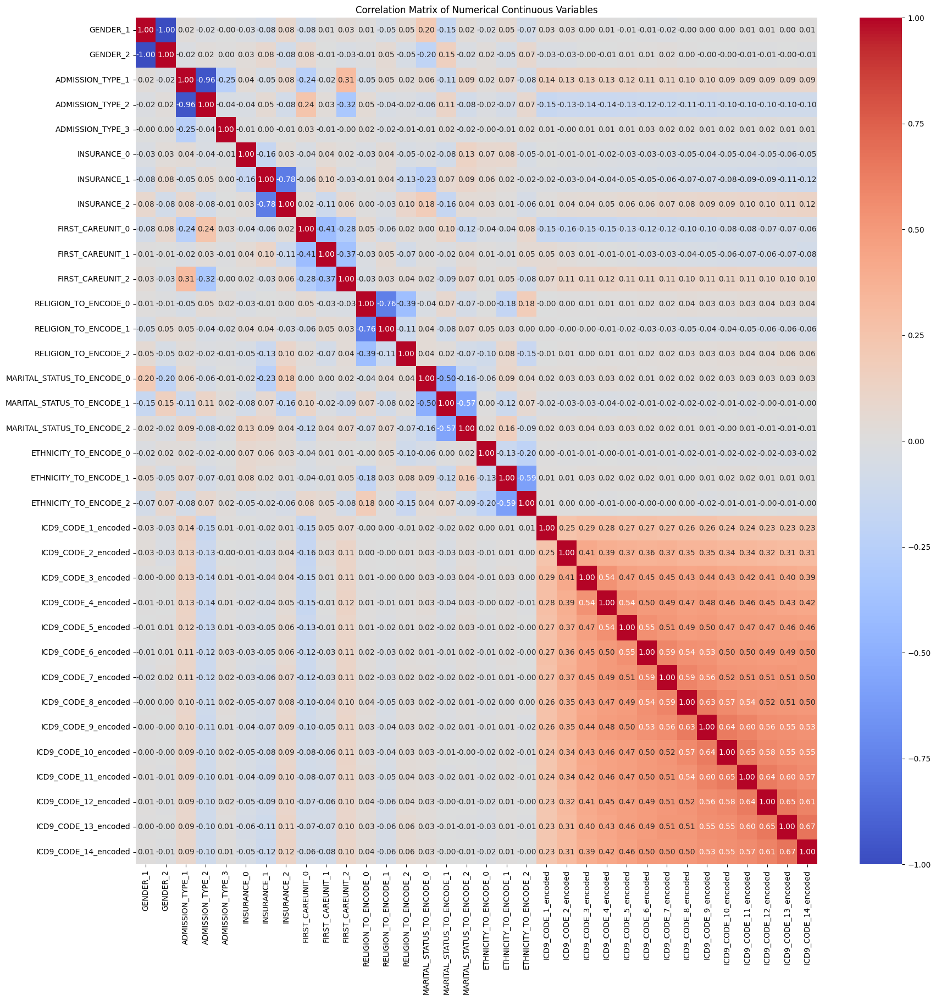

In [110]:

cat_variables_df = df_train[cat_variables]
corr = cat_variables_df.corr()
plt.figure(figsize=(20, 20))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Numerical Continuous Variables')
plt.show()

Regarding the target variable, we see that it has a higher correlation with the ICD9_CODE type of variables, that is, those that are targeted with mean of mortality, as expected. 
Beyond these, we do not obser a significant correlation with any of the other categorical variables.
Among other variables, we see of course a significant correlation between de ICD9 variables. Other than that, other high correlation are only found between categorical columns of the same category (i.e, MARITAL STATUS 2 AND MARITAL STATUS 1).
Given that we are using selectKbest in the model trainning, we expect that not all dummies from a single category will be taken.

## 5. PREPROCESSING OF NUMERICAL VARIABLES

In this section, NAS of numerical variables (vital signs) will be imputed using Iterative Imputer. Since we have variables with different scale (vital signs, ICD9 encoded, dummy variables, etc) we will standardize first and after imputation, they will be scaled ready to be inputed to the model. 
We use RobustScalar for continuous variables given to the skewed distribution of most of them. For binary variables Standard Scalar is used.

A) SCALING DATA

In [48]:
df_train.columns

Index(['subject_id', 'hadm_id', 'icustay_id', 'HeartRate_Min', 'HeartRate_Max',
       'HeartRate_Mean', 'SysBP_Min', 'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min',
       'DiasBP_Max', 'DiasBP_Mean', 'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean',
       'RespRate_Min', 'RespRate_Max', 'RespRate_Mean', 'TempC_Min',
       'TempC_Max', 'TempC_Mean', 'SpO2_Min', 'SpO2_Max', 'SpO2_Mean',
       'Glucose_Min', 'Glucose_Max', 'Glucose_Mean', 'GENDER_1', 'GENDER_2',
       'ADMISSION_TYPE_1', 'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3',
       'INSURANCE_0', 'INSURANCE_1', 'INSURANCE_2', 'FIRST_CAREUNIT_0',
       'FIRST_CAREUNIT_1', 'FIRST_CAREUNIT_2', 'LOS', 'Number Diagnoses',
       'Num_Hospital_stays', 'RELIGION_TO_ENCODE_0', 'RELIGION_TO_ENCODE_1',
       'RELIGION_TO_ENCODE_2', 'MARITAL_STATUS_TO_ENCODE_0',
       'MARITAL_STATUS_TO_ENCODE_1', 'MARITAL_STATUS_TO_ENCODE_2',
       'ETHNICITY_TO_ENCODE_0', 'ETHNICITY_TO_ENCODE_1',
       'ETHNICITY_TO_ENCODE_2', 'Age_Admission', 'ICD9_CODE_1_encoded'

In [43]:
numerical_continuous_robust=['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'Number Diagnoses', 'Num_Hospital_stays', 'Age_Admission',
       'ICD9_CODE_1_encoded', 'ICD9_CODE_2_encoded', 'ICD9_CODE_3_encoded', 'ICD9_CODE_4_encoded', 
       'ICD9_CODE_5_encoded', 'ICD9_CODE_6_encoded', 'ICD9_CODE_7_encoded', 'ICD9_CODE_8_encoded', 
       'ICD9_CODE_9_encoded', 'ICD9_CODE_10_encoded', 'ICD9_CODE_11_encoded', 'ICD9_CODE_12_encoded', 
       'ICD9_CODE_13_encoded', 'ICD9_CODE_14_encoded']

In [44]:
numerical_binary_scalar=['GENDER_1', 'GENDER_2', 'ADMISSION_TYPE_1',
       'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3', 'INSURANCE_0', 'INSURANCE_1',
       'INSURANCE_2', 'FIRST_CAREUNIT_0', 'FIRST_CAREUNIT_1',
       'FIRST_CAREUNIT_2',
       'RELIGION_TO_ENCODE_0', 'RELIGION_TO_ENCODE_1', 'RELIGION_TO_ENCODE_2',
       'MARITAL_STATUS_TO_ENCODE_0', 'MARITAL_STATUS_TO_ENCODE_1',
       'MARITAL_STATUS_TO_ENCODE_2', 'ETHNICITY_TO_ENCODE_0',
       'ETHNICITY_TO_ENCODE_1', 'ETHNICITY_TO_ENCODE_2']

In [45]:
#Fit a Robustscaler to the continuous features in the training set and transform them
RS = RobustScaler()
RS.fit(df_train[numerical_continuous_robust])
robust_scaled_train_features = RS.transform(df_train[numerical_continuous_robust])

# Apply the same scaler to the continuous features in the test set
robust_scaled_test_features = RS.transform(df_test[numerical_continuous_robust])

# Update the DataFrame with scaled features for both train and test sets
df_train[numerical_continuous_robust] = robust_scaled_train_features
df_test[numerical_continuous_robust] = robust_scaled_test_features

In [46]:
#Fit a Standardscaler to the continuous features in the training set and transform them
scaler = StandardScaler()
scaler.fit(df_train[numerical_binary_scalar])
scaled_train_features = scaler.transform(df_train[numerical_binary_scalar])

# Apply the same scaler to the continuous features in the test set
scaled_test_features = scaler.transform(df_test[numerical_binary_scalar])

# Update the DataFrame with scaled features for both train and test sets
df_train[numerical_binary_scalar] = scaled_train_features
df_test[numerical_binary_scalar] = scaled_test_features

In [47]:
all_columns=['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'Number Diagnoses', 'Num_Hospital_stays', 'Age_Admission',
       'ICD9_CODE_1_encoded', 'ICD9_CODE_2_encoded', 'ICD9_CODE_3_encoded', 'ICD9_CODE_4_encoded', 
       'ICD9_CODE_5_encoded', 'ICD9_CODE_6_encoded', 'ICD9_CODE_7_encoded', 'ICD9_CODE_8_encoded', 
       'ICD9_CODE_9_encoded', 'ICD9_CODE_10_encoded', 'ICD9_CODE_11_encoded', 'ICD9_CODE_12_encoded', 
       'ICD9_CODE_13_encoded', 'ICD9_CODE_14_encoded','GENDER_1', 'GENDER_2', 'ADMISSION_TYPE_1',
       'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3', 'INSURANCE_0', 'INSURANCE_1',
       'INSURANCE_2', 'FIRST_CAREUNIT_0', 'FIRST_CAREUNIT_1',
       'FIRST_CAREUNIT_2',
       'RELIGION_TO_ENCODE_0', 'RELIGION_TO_ENCODE_1', 'RELIGION_TO_ENCODE_2',
       'MARITAL_STATUS_TO_ENCODE_0', 'MARITAL_STATUS_TO_ENCODE_1',
       'MARITAL_STATUS_TO_ENCODE_2', 'ETHNICITY_TO_ENCODE_0',
       'ETHNICITY_TO_ENCODE_1', 'ETHNICITY_TO_ENCODE_2' ]

B) IMPUTING NAs

As commented before, KNN imputer has been tried but does not seem to work well. We have observed that NAs are present in all vital signs of many observations, therefore, it might be that KNN cannot predict well missing values. We try iterativeImputer and it seems to be performing well.
For iterativeimputer, the default estimator "BayesianRidge" is chosen as default option. The intial strategy is set to 'median' given the skewness of most of the numerical variables for which we have NAs. Max iteration is set to 10 as limit rounds if convergence is not reached. 

In [48]:
#Initialize Iterative impute
imputer_missing_values = IterativeImputer(estimator=BayesianRidge(), max_iter=10, initial_strategy='median', random_state=0)

In [49]:
#Fit and tranform Train data 
df_train[all_columns] = imputer_missing_values.fit_transform(df_train[all_columns]) 

In [50]:
#Transform Test Data
df_test[all_columns] = imputer_missing_values.transform(df_test[all_columns])

## 6. NEURAL NETWORKS

In [51]:
#Define X_train, Y_train set and X_test set
X_train_final=df_train[['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'GENDER_1', 'GENDER_2', 'ADMISSION_TYPE_1',
       'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3', 'INSURANCE_0', 'INSURANCE_1',
       'INSURANCE_2', 'FIRST_CAREUNIT_0', 'FIRST_CAREUNIT_1',
       'FIRST_CAREUNIT_2', 'Number Diagnoses', 'Num_Hospital_stays',
       'RELIGION_TO_ENCODE_0', 'RELIGION_TO_ENCODE_1', 'RELIGION_TO_ENCODE_2',
       'MARITAL_STATUS_TO_ENCODE_0', 'MARITAL_STATUS_TO_ENCODE_1',
       'MARITAL_STATUS_TO_ENCODE_2', 'ETHNICITY_TO_ENCODE_0',
       'ETHNICITY_TO_ENCODE_1', 'ETHNICITY_TO_ENCODE_2', 'Age_Admission',
       'ICD9_CODE_1_encoded', 'ICD9_CODE_2_encoded', 'ICD9_CODE_3_encoded',
       'ICD9_CODE_4_encoded', 'ICD9_CODE_5_encoded', 'ICD9_CODE_6_encoded',
       'ICD9_CODE_7_encoded', 'ICD9_CODE_8_encoded', 'ICD9_CODE_9_encoded',
       'ICD9_CODE_10_encoded', 'ICD9_CODE_11_encoded', 'ICD9_CODE_12_encoded',
       'ICD9_CODE_13_encoded', 'ICD9_CODE_14_encoded']]

y_train_final=df_train[['LOS']]

X_target=df_test[['HeartRate_Min', 'HeartRate_Max', 'HeartRate_Mean', 'SysBP_Min',
       'SysBP_Max', 'SysBP_Mean', 'DiasBP_Min', 'DiasBP_Max', 'DiasBP_Mean',
       'MeanBP_Min', 'MeanBP_Max', 'MeanBP_Mean', 'RespRate_Min',
       'RespRate_Max', 'RespRate_Mean', 'TempC_Min', 'TempC_Max', 'TempC_Mean',
       'SpO2_Min', 'SpO2_Max', 'SpO2_Mean', 'Glucose_Min', 'Glucose_Max',
       'Glucose_Mean', 'GENDER_1', 'GENDER_2', 'ADMISSION_TYPE_1',
       'ADMISSION_TYPE_2', 'ADMISSION_TYPE_3', 'INSURANCE_0', 'INSURANCE_1',
       'INSURANCE_2', 'FIRST_CAREUNIT_0', 'FIRST_CAREUNIT_1',
       'FIRST_CAREUNIT_2', 'Number Diagnoses', 'Num_Hospital_stays',
       'RELIGION_TO_ENCODE_0', 'RELIGION_TO_ENCODE_1', 'RELIGION_TO_ENCODE_2',
       'MARITAL_STATUS_TO_ENCODE_0', 'MARITAL_STATUS_TO_ENCODE_1',
       'MARITAL_STATUS_TO_ENCODE_2', 'ETHNICITY_TO_ENCODE_0',
       'ETHNICITY_TO_ENCODE_1', 'ETHNICITY_TO_ENCODE_2', 'Age_Admission',
       'ICD9_CODE_1_encoded', 'ICD9_CODE_2_encoded', 'ICD9_CODE_3_encoded',
       'ICD9_CODE_4_encoded', 'ICD9_CODE_5_encoded', 'ICD9_CODE_6_encoded',
       'ICD9_CODE_7_encoded', 'ICD9_CODE_8_encoded', 'ICD9_CODE_9_encoded',
       'ICD9_CODE_10_encoded', 'ICD9_CODE_11_encoded', 'ICD9_CODE_12_encoded',
       'ICD9_CODE_13_encoded', 'ICD9_CODE_14_encoded']]

We try a first NN with a an input layer, a hidden layer, an the outcome layer. We introduce kernel and bias regularizers as well as bias and kernel initializers. We well work with these througout all models. 
Regularizers are penalties applied to the loss function during training to prevent overfitting by penalizing large weights. Similar to kernel regularizers, bias regularizers apply penalties to the biases of each layer. Initializers determine how the weights and the bias of the network are initialized before training begins. 
We first use 'relu activation function in all layers and we might try others in the following trials. 
So far we use BatchNormalization to standardize inputs before activation.
We start by using Adam optimizer with a 0.005 learning rate. We introduce early stopping so that the model stops running when  validation loss does not improve for certain iterations.

In [262]:
Keras_MLP = Sequential([
    Dense(64, activation='relu', input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
    BatchNormalization(),    
    Dense(64, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
 
    BatchNormalization(),
    Dense(1, activation='relu',kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),
   
])

optimizer=Adam(lr=0.005)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final,  
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping]
)


Epoch 1/500



262/262 [==============================] - 4s 7ms/step - loss: 19.2511 - mean_absolute_error: 2.6890 - mean_squared_error: 19.2134 - val_loss: 18.4036 - val_mean_absolute_error: 2.6119 - val_mean_squared_error: 18.3658
Epoch 2/500
262/262 [==============================] - 1s 6ms/step - loss: 16.1188 - mean_absolute_error: 2.4529 - mean_squared_error: 16.0810 - val_loss: 17.0272 - val_mean_absolute_error: 2.4008 - val_mean_squared_error: 16.9893
Epoch 3/500
262/262 [==============================] - 1s 5ms/step - loss: 15.0323 - mean_absolute_error: 2.3110 - mean_squared_error: 14.9942 - val_loss: 16.3774 - val_mean_absolute_error: 2.3032 - val_mean_squared_error: 16.3391
Epoch 4/500
262/262 [==============================] - 1s 5ms/step - loss: 14.1819 - mean_absolute_error: 2.2201 - mean_squared_error: 14.1435 - val_loss: 16.1013 - val_mean_absolute_error: 2.2540 - val_mean_squared_error: 16.0627
Epoch 5/500
262/262 [==============================] - 1s 3ms/step - loss: 13.8212 - mea

In [263]:
print(model_NN.history.keys())

dict_keys(['loss', 'mean_absolute_error', 'mean_squared_error', 'val_loss', 'val_mean_absolute_error', 'val_mean_squared_error'])


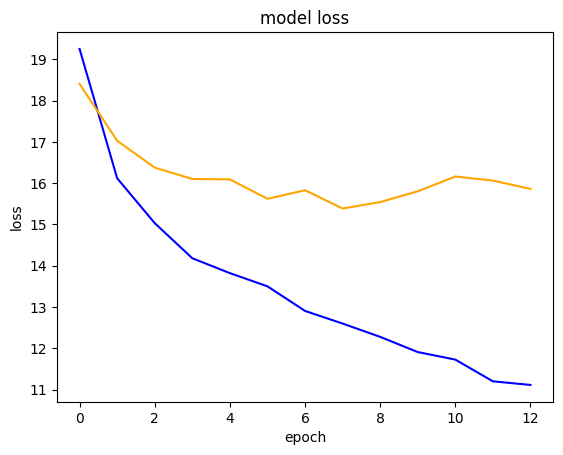

In [264]:
plt.plot(model_NN.history['loss'], label='Training Loss', color='blue')
plt.plot(model_NN.history['val_loss'], label='Validation Loss', color='orange')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.show()

We see that train loss keeps going down but validation loss stagnates, which is a clear sign of overfitting. Therefore, we will add dropout rates into our layers. We try with different rates usually using a slighlty smaller rate for the input layer, however, we still do not find losses to converge at a decent loss. Lower losses are obtained with the smallest dropout rates we've tried (0.05 for input layers and 0.1 for the rest).

In [298]:
Keras_MLP = Sequential([
    Dense(64, activation='relu', input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
    Dropout(0.05),
    BatchNormalization(),
    Dense(64, activation='relu',kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
    Dropout(0.1),
    BatchNormalization(),
    Dense(1, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),
   
])

optimizer=Adam(lr=0.005)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final, 
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping]
)

Epoch 1/500


262/262 [==============================] - 6s 12ms/step - loss: 21.6460 - mean_absolute_error: 2.8205 - mean_squared_error: 21.6081 - val_loss: 19.1467 - val_mean_absolute_error: 2.5373 - val_mean_squared_error: 19.1087
Epoch 2/500
262/262 [==============================] - 2s 7ms/step - loss: 19.0215 - mean_absolute_error: 2.5977 - mean_squared_error: 18.9834 - val_loss: 17.4809 - val_mean_absolute_error: 2.4245 - val_mean_squared_error: 17.4428
Epoch 3/500
262/262 [==============================] - 2s 6ms/step - loss: 17.9547 - mean_absolute_error: 2.5089 - mean_squared_error: 17.9165 - val_loss: 16.8686 - val_mean_absolute_error: 2.2728 - val_mean_squared_error: 16.8303
Epoch 4/500
262/262 [==============================] - 1s 6ms/step - loss: 17.6285 - mean_absolute_error: 2.4225 - mean_squared_error: 17.5901 - val_loss: 16.7138 - val_mean_absolute_error: 2.2012 - val_mean_squared_error: 16.6752
Epoch 5/500
262/262 [==============================] - 1s 5ms/step - loss: 16.9705 - me

In [266]:
model_NN.history.keys()

dict_keys(['loss', 'mean_absolute_error', 'mean_squared_error', 'val_loss', 'val_mean_absolute_error', 'val_mean_squared_error'])

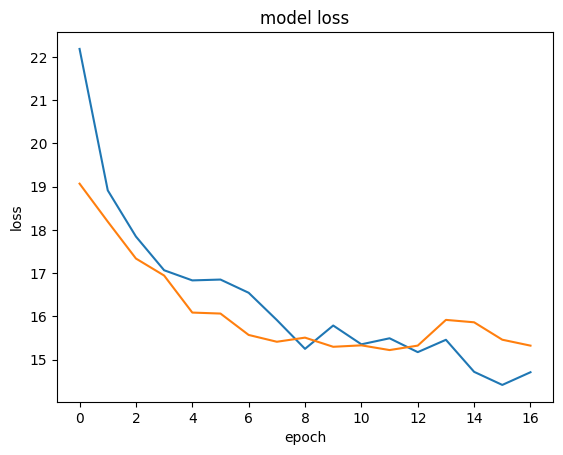

In [267]:
plt.plot(model_NN.history['loss'], label='Training Loss')
plt.plot(model_NN.history['val_loss'], label='Validation Loss')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
#plt.legend(['train'], loc='upper left')
plt.show()

We try the same structure but decreasing the learning rate to 0.001 to make the model to learn slowlier but at the same time and increase dropout rates a bit to prevent overfitting.

In [302]:
Keras_MLP = Sequential([
    Dense(128, 
          input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
     
    BatchNormalization(),
    Activation('relu'),
    Dropout(0.1),
    
    Dense(64, 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
    BatchNormalization(),
    Activation('relu'),
    Dropout(0.2),

    Dense(1, 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),
    BatchNormalization(),
    Activation('relu'),
 
])

optimizer=Adam(lr=0.001)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final,  
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping]
)

Epoch 1/500


262/262 [==============================] - 5s 8ms/step - loss: 32.7160 - mean_absolute_error: 3.3011 - mean_squared_error: 32.6570 - val_loss: 30.5144 - val_mean_absolute_error: 3.0994 - val_mean_squared_error: 30.4553
Epoch 2/500
262/262 [==============================] - 2s 6ms/step - loss: 29.8604 - mean_absolute_error: 3.1556 - mean_squared_error: 29.8013 - val_loss: 30.2047 - val_mean_absolute_error: 3.0796 - val_mean_squared_error: 30.1454
Epoch 3/500
262/262 [==============================] - 1s 6ms/step - loss: 27.9220 - mean_absolute_error: 3.0173 - mean_squared_error: 27.8625 - val_loss: 28.3140 - val_mean_absolute_error: 2.9528 - val_mean_squared_error: 28.2543
Epoch 4/500
262/262 [==============================] - 1s 5ms/step - loss: 26.1418 - mean_absolute_error: 2.8891 - mean_squared_error: 26.0819 - val_loss: 26.1343 - val_mean_absolute_error: 2.8256 - val_mean_squared_error: 26.0744
Epoch 5/500
262/262 [==============================] - 1s 5ms/step - loss: 24.7837 - mea

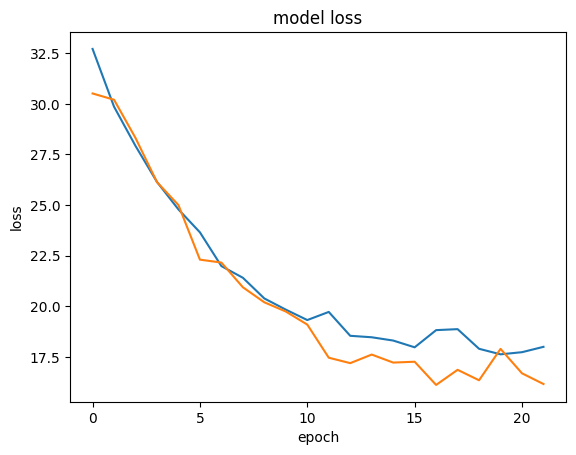

In [303]:
model_NN.history.keys()
plt.plot(model_NN.history['loss'], label='Training Loss')
plt.plot(model_NN.history['val_loss'], label='Validation Loss')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.show()

We observe more convergence than before but we try different structures to try to obtain lower losses and better predictions. 

We increment the size of the input layer to check if the model could be capturing more complexity. We then increase a bit the dropout rate because  if the model is capturing more complexity, it might be overfitting more easily. We also change the last activation function to exponential (we try others like linear or softmax but do not work well).

In [280]:
Keras_MLP = Sequential([
    Dense(128, activation='relu', input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
    Dropout(0.3),
    
    BatchNormalization(),
    Dense(64, activation='relu',kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
    Dropout(0.2),
    
    BatchNormalization(),
    Dense(1, activation='exponential',
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),

])

optimizer=Adam(lr=0.001)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final, 
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping]
)

Epoch 1/500


262/262 [==============================] - 3s 5ms/step - loss: 36.8775 - mean_absolute_error: 3.1942 - mean_squared_error: 36.8180 - val_loss: 31.5968 - val_mean_absolute_error: 2.7939 - val_mean_squared_error: 31.5372
Epoch 2/500
262/262 [==============================] - 1s 4ms/step - loss: 33.6389 - mean_absolute_error: 3.0343 - mean_squared_error: 33.5791 - val_loss: 31.7171 - val_mean_absolute_error: 2.8121 - val_mean_squared_error: 31.6572
Epoch 3/500
262/262 [==============================] - 1s 4ms/step - loss: 31.0480 - mean_absolute_error: 2.9396 - mean_squared_error: 30.9879 - val_loss: 27.6707 - val_mean_absolute_error: 2.6833 - val_mean_squared_error: 27.6105
Epoch 4/500
262/262 [==============================] - 1s 4ms/step - loss: 30.1183 - mean_absolute_error: 2.9014 - mean_squared_error: 30.0580 - val_loss: 27.9725 - val_mean_absolute_error: 2.6410 - val_mean_squared_error: 27.9121
Epoch 5/500
262/262 [==============================] - 1s 4ms/step - loss: 26.3269 - mea

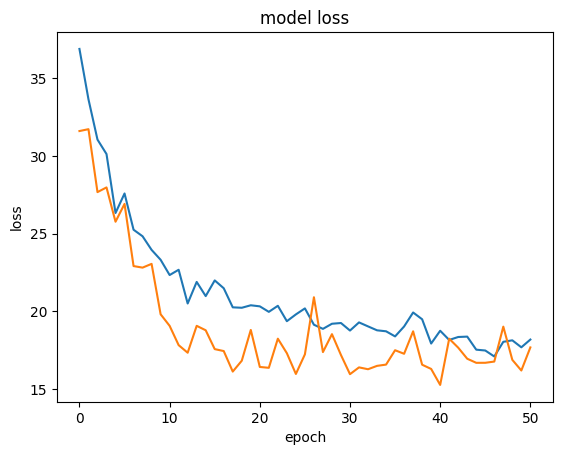

In [281]:
model_NN.history.keys()
plt.plot(model_NN.history['loss'], label='Training Loss')
plt.plot(model_NN.history['val_loss'], label='Validation Loss')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.show()

It converges but it looks a bit noisy. As last method to try, we introduce a parameter that will be adjusting the learning_rate as the model runs so that it can learn at a bigger rate in the beginning but later on, decrease the rate to prevent overfitting. 

In [283]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.05, patience=5, min_lr=0.0001)

In [292]:
Keras_MLP = Sequential([
    Dense(128, activation='relu', input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
    Dropout(0.05),
    BatchNormalization(),
    Dense(64, activation='relu',kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
    Dropout(0.1),
    BatchNormalization(),
    Dense(1, activation='exponential', kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),
])

optimizer=Adam(lr=0.007)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final, 
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping, reduce_lr]
)


Epoch 1/500


262/262 [==============================] - 3s 5ms/step - loss: 32.6301 - mean_absolute_error: 2.9249 - mean_squared_error: 32.5712 - val_loss: 29.8366 - val_mean_absolute_error: 2.7113 - val_mean_squared_error: 29.7776 - lr: 0.0010
Epoch 2/500
262/262 [==============================] - 1s 5ms/step - loss: 30.0703 - mean_absolute_error: 2.7985 - mean_squared_error: 30.0111 - val_loss: 32.5353 - val_mean_absolute_error: 2.7935 - val_mean_squared_error: 32.4758 - lr: 0.0010
Epoch 3/500
262/262 [==============================] - 2s 6ms/step - loss: 78.9031 - mean_absolute_error: 2.9633 - mean_squared_error: 78.8433 - val_loss: 37.0193 - val_mean_absolute_error: 2.9574 - val_mean_squared_error: 36.9590 - lr: 0.0010
Epoch 4/500
262/262 [==============================] - 2s 7ms/step - loss: 34.7153 - mean_absolute_error: 3.0305 - mean_squared_error: 34.6549 - val_loss: 36.2186 - val_mean_absolute_error: 2.9136 - val_mean_squared_error: 36.1582 - lr: 0.0010
Epoch 5/500
262/262 [===============

In [293]:
print(model_NN.history.keys())

dict_keys(['loss', 'mean_absolute_error', 'mean_squared_error', 'val_loss', 'val_mean_absolute_error', 'val_mean_squared_error', 'lr'])


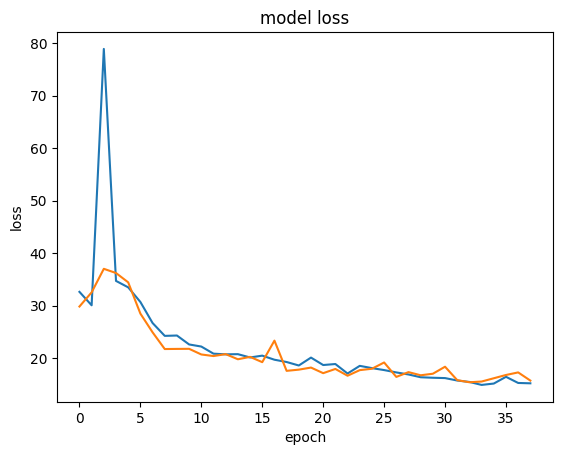

In [294]:
model_NN.history.keys()
plt.plot(model_NN.history['loss'], label='Training Loss')
plt.plot(model_NN.history['val_loss'], label='Validation Loss')
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
#plt.legend(['train'], loc='upper left')
plt.show()

After all trials, the structure that seems to wrok better is the following one (the second trial) with 64 size input layer, dropout rate of 0.05 for the input layer and 0.1 for the hidden and a learning rate of 0.005 for the optimizer. 


In [ ]:
"""Keras_MLP = Sequential([
    Dense(64, activation='relu', input_shape=(61, ), 
          kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(), 
          bias_regularizer=regularizers.l2(1e-4)), 
    Dropout(0.05),
    BatchNormalization(),
    Dense(64, activation='relu',kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          kernel_initializer=initializers.HeNormal(), 
          bias_initializer=initializers.Zeros(),
          bias_regularizer=regularizers.l2(1e-4)),
    Dropout(0.1),
    BatchNormalization(),
    Dense(1, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=1e-5, l2=1e-4), 
          bias_regularizer=regularizers.l2(1e-4),
          bias_initializer=initializers.Zeros(),
          kernel_initializer=initializers.HeNormal()),
])

optimizer=Adam(lr=0.005)

Keras_MLP.compile(
    optimizer=optimizer,
    loss='mean_squared_error',  
    metrics=['mean_absolute_error', 'mean_squared_error']  
)

early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

model_NN=Keras_MLP.fit(
    X_train_final,
    y_train_final, 
    epochs=500,
    batch_size=64,
    validation_split=0.2,  
    callbacks=[early_stopping]
)"""

In [304]:
predictions = Keras_MLP.predict(X_target)

164/164 [==============================] - 0s 2ms/step


In [305]:
predictions = predictions.flatten()

In [306]:
test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions})
test_predictions_submit.to_csv("test_predictions_submit_NN_2.csv", index = False)

## 7. ENSEMBLING

In [54]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor

We will run ensembling using stacking and blending. First of all, we will fine tune each base learner (KNN, RandomForest and XGB) doing gridsearches to find optimal parameters for each as well as their k-best features.

### 7.1. FINE-TUNING BASE LEARNERS

**Model 1: KNN**

We first do grid searching over each model individually that will feed our metalearner. 
We start by gridsearching over the KNNRegressor. T
he steps initiated are feature selection with SelectKBest and KNN Classifier. 
Regarding Kbest parameters, the range of number of features over which to choose is set between 10 and 60. 
For KNN parameters, we set algorithm to be 'brute' since it is the one comparing neighbor to neighbor and even if it is computationally expensive, in this case is manageable.  
As a number of neighbors, a range between 100 and 500 is set. As type of weight, distance is chosen because we expect to perform better in most of the cases since it gives more weights to closest neighbors.

In [224]:

"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('knn', KNeighborsRegressor())
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [10, 20, 30, 40, 50, 60],  
    'knn__n_neighbors': [100, 200, 300, 400, 500],
    'knn__weights': ['distance'],
    'knn__algorithm':['brute']      
}

grid_knn_acc = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_knn_acc.fit(X_train_final, y_train_final)
print("Best parameters:", grid_knn_acc.best_params_)
print("Best Score:", grid_knn_acc.best_score_)"""

Best parameters: {'feature_selection__k': 30, 'knn__algorithm': 'brute', 'knn__n_neighbors': 100, 'knn__weights': 'distance'}
Best Score: -15.780178547121357


As a result of the previous search, we obtain the following results:

Best parameters: {'feature_selection__k': 30, 'knn__algorithm': 'brute', 'knn__n_neighbors': 100, 'knn__weights': 'distance'}.

Best Score: -15.780178547121357.

So we narrow down the parameters of the grid search:


In [226]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('knn', KNeighborsRegressor())
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [22, 25, 28, 30, 32, 35],  
    'knn__n_neighbors': [30, 50, 70, 90, 100, 120, 140, 150],
    'knn__weights': ['distance'],
    'knn__algorithm':['brute']      
}

grid_knn_acc = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_knn_acc.fit(X_train_final, y_train_final)
print("Best parameters:", grid_knn_acc.best_params_)
print("Best Score:", grid_knn_acc.best_score_)"""

Best parameters: {'feature_selection__k': 25, 'knn__algorithm': 'brute', 'knn__n_neighbors': 30, 'knn__weights': 'distance'}
Best Score: -15.264164784898274


The following parameters are obtained:

Best parameters: {'feature_selection__k': 25, 'knn__algorithm': 'brute', 'knn__n_neighbors': 30, 'knn__weights': 'distance'}.

Best Score: -15.264164784898274

So we narrow down again final GridSearch.

In [228]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('knn', KNeighborsRegressor())
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [22, 23, 24, 25, 26, 27],  
    'knn__n_neighbors': [10, 25, 20, 25, 30, 25, 40],
    'knn__weights': ['distance'],
    'knn__algorithm':['brute']      
}

grid_knn_acc = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_knn_acc.fit(X_train_final, y_train_final)
print("Best parameters:", grid_knn_acc.best_params_)
print("Best Score:", grid_knn_acc.best_score_)"""

Best parameters: {'feature_selection__k': 25, 'knn__algorithm': 'brute', 'knn__n_neighbors': 25, 'knn__weights': 'distance'}
Best Score: -15.258739429724741


The resulting best parameters for KNNRegressor are the following ones:

Best parameters: {'feature_selection__k': 25, 'knn__algorithm': 'brute', 'knn__n_neighbors': 25, 'knn__weights': 'distance'}.

Best Score: -15.258739429724741.

We train the model on the whole dataset with the optimal parameters.


In [55]:

MyKNN = KNeighborsRegressor(n_neighbors=25, algorithm='brute', weights='distance')

selector = SelectKBest(score_func=f_classif, k=25)
X_train_selected = selector.fit_transform(X_train_final, y_train_final)

MyKNN.fit(X_train_selected, y_train_final)

KNeighborsRegressor(algorithm='brute', n_neighbors=25, weights='distance')

**Model 2: Random Forest**

To perform the GridSearch for the second model RandomForest, we do it with a subsample to reduce significantly the time.
 
The steps initiated are feature selection with SelectKBest and RandomForest Regressor.. 
Regarding Kbest parameters, the range of number of features over which to choose is set between 20 and 60. 
For RF parameters, we set some parameters such as n_estimators, max_depth and min_samples_split with a certain range for each of them.


In [163]:
# Split the data into a smaller subset for faster grid search
X_train_subsample = X_train_final[:2000]
y_train_subsample = y_train_final[:2000]

In [168]:
# Define the pipeline
"""pipeline_rf = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('rf', RandomForestRegressor(bootstrap=True))
])

# Define parameter grid
param_grid_rf = {
    'feature_selection__k': [20, 40, 60],
    'rf__n_estimators': [100, 150, 200],
    'rf__max_depth': [5, 10],
    'rf__min_samples_split': [2, 5]  
}

# Create GridSearchCV object
grid_rf = GridSearchCV(pipeline_rf, param_grid_rf, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_rf.fit(X_train_subsample, y_train_subsample)

# Print best parameters and score
print("Best parameters:", grid_rf.best_params_)
print("Best Score:", grid_rf.best_score_)"""

Best parameters: {'feature_selection__k': 60, 'rf__max_depth': 10, 'rf__min_samples_split': 2, 'rf__n_estimators': 100}
Best Score: -16.696440593110076


We get the following results:

Best parameters: {'feature_selection__k': 60, 'rf__max_depth': 10, 'rf__min_samples_split': 2, 'rf__n_estimators': 100}

Best Score: -16.696440593110076

We narrow down the parameters of the GridSearch:

In [170]:
# Define the pipeline
"""pipeline_rf = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('rf', RandomForestRegressor(bootstrap=True))
])

# Define parameter grid
param_grid_rf = {
    'feature_selection__k': [45, 55, 61],
    'rf__n_estimators': [50, 100, 150],
    'rf__max_depth': [7, 10, 12],
    'rf__min_samples_split': [2, 4]  
}

# Create GridSearchCV object
grid_rf = GridSearchCV(pipeline_rf, param_grid_rf, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_rf.fit(X_train_subsample, y_train_subsample)

# Print best parameters and score
print("Best parameters:", grid_rf.best_params_)
print("Best Score:", grid_rf.best_score_)"""

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 12, 'rf__min_samples_split': 4, 'rf__n_estimators': 50}
Best Score: -16.681917437889798


The obtained results are the following:

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 12, 'rf__min_samples_split': 4, 'rf__n_estimators': 50}

Best Score: -16.681917437889798

We narrow down the parameters of the Grid Search.


In [171]:
# Define the pipeline
"""pipeline_rf = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('rf', RandomForestRegressor(bootstrap=True))
])

# Define parameter grid
param_grid_rf = {
    'feature_selection__k': [61],
    'rf__n_estimators': [25, 50, 75],
    'rf__max_depth': [10, 12, 14],
    'rf__min_samples_split': [3, 4, 6]  
}

# Create GridSearchCV object
grid_rf = GridSearchCV(pipeline_rf, param_grid_rf, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_rf.fit(X_train_subsample, y_train_subsample)

# Print best parameters and score
print("Best parameters:", grid_rf.best_params_)
print("Best Score:", grid_rf.best_score_)"""

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 10, 'rf__min_samples_split': 6, 'rf__n_estimators': 50}
Best Score: -16.54250988686598


The obtained results are the following: 

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 10, 'rf__min_samples_split': 6, 'rf__n_estimators': 50}

Best Score: -16.54250988686598

We narrow down the parameters:


In [178]:
# Define the pipeline
"""pipeline_rf = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('rf', RandomForestRegressor(bootstrap=True))
])

# Define parameter grid
param_grid_rf = {
    'feature_selection__k': [61],
    'rf__n_estimators': [50],
    'rf__max_depth': [None, 8, 10, 12],
    'rf__min_samples_split': [2, 4, 6, 7, 8, 10, 12]  
}

# Create GridSearchCV object
grid_rf = GridSearchCV(pipeline_rf, param_grid_rf, scoring='neg_mean_squared_error', cv=5, n_jobs=-1)
grid_rf.fit(X_train_subsample, y_train_subsample)

# Print best parameters and score
print("Best parameters:", grid_rf.best_params_)
print("Best Score:", grid_rf.best_score_)"""

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 8, 'rf__min_samples_split': 7, 'rf__n_estimators': 50}
Best Score: -16.694918493707014


we obtain the following results:

Best parameters: {'feature_selection__k': 61, 'rf__max_depth': 8, 'rf__min_samples_split': 7, 'rf__n_estimators': 50}

Best Score: -16.694918493707014

We run the final model with these parameters:

In [179]:

RF = RandomForestRegressor(n_estimators=50, max_depth=8, min_samples_split=7)
RF.fit(X_train_final, y_train_final)

RandomForestRegressor(max_depth=8, min_samples_split=7, n_estimators=50)

**Model 3: XGB REGRESSOR**

To perform the GridSearch for the third model -XGB- the steps initiated are feature selection with SelectKBest and the XGBRegressor.. 
Regarding Kbest parameters, the range of number of features over which to choose is set between 20 and 60. 
For XGB parameters, we set some parameters such as max_depth, the parameter of regularisation lambda and the learning rate.

In [153]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('xgb', XGBRegressor(eval_metric='rmse', seed=0))
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [20, 40, 60],  
    'xgb__lambda': [0.5, 1.5],
    'xgb__max_depth': [4,  8],
    'xgb__learning_rate':[0.05,1]
          
}

grid_xgb = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_xgb.fit(X_train_final, y_train_final)
print("Best parameters:", grid_xgb.best_params_)
print("Best Score:", grid_xgb.best_score_)"""

Best parameters: {'feature_selection__k': 60, 'xgb__lambda': 1.5, 'xgb__learning_rate': 0.05, 'xgb__max_depth': 8}
Best Score: -12.442353458739055


The results obtained in the first GridSearch are the following:

Best parameters: {'feature_selection__k': 60, 'xgb__lambda': 1.5, 'xgb__learning_rate': 0.05, 'xgb__max_depth': 8}

Best Score: -12.442353458739055

Therefore, we do another GridSearch narrowing down the parameters.


In [159]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('xgb', XGBRegressor(eval_metric='rmse', seed=0))
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [45, 55, 61],  
    'xgb__lambda': [1, 1.5, 2],
    'xgb__max_depth': [7,8,10],
    'xgb__learning_rate':[0.03,0.05,0.07]
          
}

grid_xgb = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_xgb.fit(X_train_final, y_train_final)
print("Best parameters:", grid_xgb.best_params_)
print("Best Score:", grid_xgb.best_score_)"""

Best parameters: {'feature_selection__k': 61, 'xgb__lambda': 2, 'xgb__learning_rate': 0.07, 'xgb__max_depth': 7}
Best Score: -12.229853247880778


The obtained results are the following:

Best parameters: {'feature_selection__k': 61, 'xgb__lambda': 2, 'xgb__learning_rate': 0.07, 'xgb__max_depth': 7}

Best Score: -12.229853247880778

We narrow down more the parameters:


In [160]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('xgb', XGBRegressor(eval_metric='rmse', seed=0))
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [57,61],  
    'xgb__lambda': [1.7, 2, 2.5],
    'xgb__max_depth': [6, 7, 8],
    'xgb__learning_rate':[0.07, 1, 1.5]
          
}

grid_xgb = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_xgb.fit(X_train_final, y_train_final)
print("Best parameters:", grid_xgb.best_params_)
print("Best Score:", grid_xgb.best_score_)"""

Best parameters: {'feature_selection__k': 57, 'xgb__lambda': 2, 'xgb__learning_rate': 0.07, 'xgb__max_depth': 7}
Best Score: -12.177258214706418


The obtained results are the following:

Best parameters: {'feature_selection__k': 57, 'xgb__lambda': 2, 'xgb__learning_rate': 0.07, 'xgb__max_depth': 7}

Best Score: -12.177258214706418

We narrow down more the parameters:




In [162]:
"""pipeline = Pipeline([
    ('feature_selection', SelectKBest(score_func=f_classif)),
    ('xgb', XGBRegressor(eval_metric='rmse', seed=0))
])

# Define parameter grid
param_grid = {
    'feature_selection__k': [56,57,59,61],  
    'xgb__lambda': [2],
    'xgb__max_depth': [7],
    'xgb__learning_rate':[0.02, 0.05, 0.08, 1]
          
}

grid_xgb = GridSearchCV(pipeline, param_grid, scoring = 'neg_mean_squared_error', cv=10, n_jobs=-1)
grid_xgb.fit(X_train_final, y_train_final)
print("Best parameters:", grid_xgb.best_params_)
print("Best Score:", grid_xgb.best_score_)"""

Best parameters: {'feature_selection__k': 59, 'xgb__lambda': 2, 'xgb__learning_rate': 0.08, 'xgb__max_depth': 7}
Best Score: -12.236461173086553


We fit the model with the best parameters from the last GridSearch:

Best parameters: {'feature_selection__k': 59, 'xgb__lambda': 2, 'xgb__learning_rate': 0.08, 'xgb__max_depth': 7}

Best Score: -12.236461173086553

We train the final model with such parameters




In [57]:

XGB = XGBRegressor(max_depth=7, learning_rate=0.08, reg_lambda=2)

selector = SelectKBest(score_func=f_classif, k=59)
X_train_selected = selector.fit_transform(X_train_final, y_train_final)

XGB.fit(X_train_selected, y_train_final)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.08, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=7, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

### 7.1. ENSEMBLING: STACKING

We are going to do ensembling in three different ways. The first one will be using Stacking

In [183]:
np.int = np.int64
SEED=3642
models = [MyKNN, RF, XGB]

In [60]:
# Train test split
X_train, X_test ,y_train, y_test = train_test_split(X_train_final, y_train_final, test_size=0.7, shuffle=True, random_state=SEED)

We compare the results of Stacking using different meta_learners such as ExtreTreesRgressor, RFRegressor, Gradient Boosting, AdaBoost and LGB so we can check wich one performs better. To begin with, we put some parameters that could work and later on, we will perform GridSearch on the parameters of the metalearner that seems to work best.

In [184]:
"""meta_learners = [
    ExtraTreesRegressor(n_estimators=100, max_features=0.5, bootstrap=True, random_state=SEED),
    RandomForestRegressor(n_estimators=100, max_features=0.5, bootstrap=True, random_state=SEED),
    GradientBoostingRegressor(learning_rate=0.1, n_estimators=100, random_state=SEED),
    AdaBoostRegressor(n_estimators=100, learning_rate=0.1, random_state=SEED),
    lgb.LGBMRegressor(n_estimators=100, learning_rate=0.1, random_state=SEED)
]

meta_learners_ = ['ExtraTrees', 'RandomForest', 'GradientBoosting', 'AdaBoost', 'LGB']

scores = {}

for i, meta_learner in enumerate(meta_learners):
    super_learner = SuperLearner(folds=5, random_state=SEED)

    super_learner.add(models)
    super_learner.add_meta(meta_learner)
    super_learner.fit(X_train, y_train)

    y_pred_tr = super_learner.predict(X_train)
    mse_tr = mean_squared_error(y_train, y_pred_tr)
    
    y_pred = super_learner.predict(X_test)
    mse_tst = mean_squared_error(y_test, y_pred)
    
    scores[f'Stacking{meta_learners_[i]}'] = (super_learner, mean_squared_error)
    print(f'Super Learner with {meta_learners_[i]} MSE score on train sample: {mse_tr}')
    print(f'Super Learner with {meta_learners_[i]} MSE score on test sample: {mse_tst}\n')"""

Super Learner with ExtraTrees MSE score on train sample: 17.660380511832727
Super Learner with ExtraTrees MSE score on test sample: 14.471784207948165

Super Learner with RandomForest MSE score on train sample: 12.816608423150338
Super Learner with RandomForest MSE score on test sample: 14.698923122471117

Super Learner with GradientBoosting MSE score on train sample: 36.57543862001298
Super Learner with GradientBoosting MSE score on test sample: 15.710493891169348

Super Learner with AdaBoost MSE score on train sample: 34.60851325491721
Super Learner with AdaBoost MSE score on test sample: 17.68952818731279

Super Learner with LGB MSE score on train sample: 7.187423053798672
Super Learner with LGB MSE score on test sample: 14.483255841320418



Extratrees, RandomForest and LGB look like the best performing metalearners. We make fit them on the whole training dataset and make some predictions with them.

In [185]:
#Fit ExtraTrees
"""extra_trees_model = meta_learners[0]
extra_trees_model.fit(X_train_final, y_train_final)"""

ExtraTreesRegressor(bootstrap=True, max_features=0.5, random_state=3642)

In [186]:
#Fit RF model
"""rf_model = meta_learners[1]
rf_model.fit(X_train_final, y_train_final)"""

RandomForestRegressor(max_features=0.5, random_state=3642)

In [187]:
#Fit LGB model
"""lgb_model = meta_learners[4]
lgb_model.fit(X_train_final, y_train_final)"""

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046


LGBMRegressor(random_state=3642)

In [188]:
"""predictions_extratrees = extra_trees_model.predict(X_target)
predictions_rf=rf_model.predict(X_target)
predictions_lgbmodel = lgb_model.predict(X_target)

test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions_lgbmodel})
test_predictions_submit.to_csv("test_predictions_submit_ensemble.csv", index = False)"""

We see how train and test scores are quite different, which means we could be overfitting. Therefore, for ExtraTrees and RandomForest we change parameters such as Max_depth (set to a limit of 10), min_samples_split(set to 5 instead of default 2) and min_samples_leaf set to 3 (instead of default 1) to prevent overfitting.
For LGB, we decrease the learning rate from 0.1 to 0.05 and increase number of estimators to make the model to converge more slowly and we also set max_depth to 5 and min_child_sample to 25 (default is 20).

In [189]:
meta_learners = [
    ExtraTreesRegressor(n_estimators=150, max_features=0.5, max_depth=10, min_samples_split=5, min_samples_leaf=3, bootstrap=True, random_state=SEED),
    RandomForestRegressor(n_estimators=150, max_features=0.5, max_depth=10, min_samples_split=5, min_samples_leaf=3, bootstrap=True, random_state=SEED),
    lgb.LGBMRegressor(n_estimators=150, learning_rate=0.05, max_depth=5, min_child_samples=25, random_state=SEED)
]

meta_learners_ = ['ExtraTrees', 'RandomForest', 'LGB']

scores = {}

for i, meta_learner in enumerate(meta_learners):
    super_learner = SuperLearner(folds=5, random_state=SEED)

    super_learner.add(models)
    super_learner.add_meta(meta_learner)
    super_learner.fit(X_train, y_train)

    y_pred_tr = super_learner.predict(X_train)
    mse_tr = mean_squared_error(y_train, y_pred_tr)
    
    y_pred = super_learner.predict(X_test)
    mse_tst = mean_squared_error(y_test, y_pred)
    
    scores[f'Stacking{meta_learners_[i]}'] = (super_learner, mean_squared_error)
    print(f'Super Learner with {meta_learners_[i]} MSE score on train sample: {mse_tr}')
    print(f'Super Learner with {meta_learners_[i]} MSE score on test sample: {mse_tst}\n')

Super Learner with ExtraTrees MSE score on train sample: 5.191024315922708
Super Learner with ExtraTrees MSE score on test sample: 13.848958490742294

Super Learner with RandomForest MSE score on train sample: 9.394010734463967
Super Learner with RandomForest MSE score on test sample: 13.722064900894253

Super Learner with LGB MSE score on train sample: 5.22284186531221
Super Learner with LGB MSE score on test sample: 13.872307784711007



In [190]:
ext_model_2 = meta_learners[0]
ext_model_2.fit(X_train_final, y_train_final)

ExtraTreesRegressor(bootstrap=True, max_depth=10, max_features=0.5,
                    min_samples_leaf=3, min_samples_split=5, n_estimators=150,
                    random_state=3642)

In [191]:
rf_model_2 = meta_learners[1]
rf_model_2.fit(X_train_final, y_train_final)

RandomForestRegressor(max_depth=10, max_features=0.5, min_samples_leaf=3,
                      min_samples_split=5, n_estimators=150, random_state=3642)

In [145]:
lgb_model_2 = meta_learners[2]
lgb_model_2.fit(X_train_final, y_train_final)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

LGBMRegressor(learning_rate=0.05, max_depth=5, min_child_samples=25,
              n_estimators=150, random_state=3642)

In [193]:
#Make and submit predictions
predictions_ext_model_2 = ext_model_2.predict(X_target)
pred_rf_model_2=rf_model_2.predict(X_target)
predictions_lgb_2 = lgb_model_2.predict(X_target)

test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions_lgb_2})
test_predictions_submit.to_csv("test_predictions_submit_ensemble.csv", index = False)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


So far, LGB out of sample predictions (KAGGLE) seem to be outperforming those of the other two models, so we will do GridSearch over a range of parameters that contain the last parameters we used for the LGB metalearner.

In [200]:
#
meta_learners = [
    lgb.LGBMRegressor(random_state=SEED)]

meta_learners_ = ['LGB']

# Initialize a dictionary to store MSE scores for each meta-learner
scores = {}

# Loop over each meta-learner
for i, meta_learner in enumerate(meta_learners):
    # Define the parameter grid for GridSearchCV
    param_grid = {
        'n_estimators': [100, 150, 200],
        'learning_rate': [0.02, 0.05, 0.1, 0.2],
        'max_depth': [3, 5, 7, 10, 12, 14],
        'min_child_samples': [10, 25, 50, 60],
        'reg_alpha': [0, 0.1, 0.5],
    }
    
    # Initialize the LightGBM regressor
    lgb_regressor = lgb.LGBMRegressor(random_state=SEED)
    
    # Initialize and fit the GridSearchCV
    grid_search = GridSearchCV(estimator=lgb_regressor, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5)
    grid_search.fit(X_train, y_train)
    
    # Get the best parameters and best score
    best_params = grid_search.best_params_
    best_score = -grid_search.best_score_
    
    # Create LightGBM meta-learner with best parameters
    meta_learner_best = lgb.LGBMRegressor(**best_params, random_state=SEED)
    
    # Initialize SuperLearner with the best LightGBM meta-learner
    super_learner = SuperLearner(folds=5, random_state=SEED)
    super_learner.add(models)
    super_learner.add_meta(meta_learner_best)
    super_learner.fit(X_train, y_train)
    
    # Make predictions
    y_pred_train = super_learner.predict(X_train)
    y_pred_test = super_learner.predict(X_test)
    
    # Calculate MSE scores
    mse_train = mean_squared_error(y_train, y_pred_train)
    mse_test = mean_squared_error(y_test, y_pred_test)
    
    # Store MSE scores in the dictionary
    scores[f'Stacking{meta_learners_[i]}'] = (super_learner, mse_train, mse_test)
    
    # Print MSE scores
    print(f'Super Learner with {meta_learners_[i]} MSE score on train sample: {mse_train}')
    print(f'Super Learner with {meta_learners_[i]} MSE score on test sample: {mse_test}\n')


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001693 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9603
[LightGBM] [Info] Number of data points in the train set: 5012, number of used features: 61
[LightGBM] [Info] Start training from score 3.626737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001594 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9613
[LightGBM] [Info] Number of data points in the train set: 5012, number of used features: 61
[LightGBM] [Info] Start training from score 3.664887
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

In [202]:
best_params = grid_search.best_params_
best_score = -grid_search.best_score_
    
    # Output the best parameters
print("Best Parameters for LGBMRegressor:")
print(best_params)
print(best_score)

Best Parameters for LGBMRegressor:
{'learning_rate': 0.05, 'max_depth': 10, 'min_child_samples': 50, 'n_estimators': 200, 'reg_alpha': 0.1}
14.998237629150978


We do a final stacking with the best parameters obtained from the Grid Search and make predictions
Best Parameters for LGBMRegressor:

{'learning_rate': 0.05, 'max_depth': 10, 'min_child_samples': 50, 'n_estimators': 200, 'reg_alpha': 0.1}


In [197]:
meta_learners = [
    lgb.LGBMRegressor(n_estimators=200, learning_rate=0.05, max_depth=10, min_child_samples=50, reg_alpha=0.1, random_state=SEED)
]

meta_learners_ = ['LGB']

scores = {}

for i, meta_learner in enumerate(meta_learners):
    super_learner = SuperLearner(folds=5, random_state=SEED)

    super_learner.add(models)
    super_learner.add_meta(meta_learner)
    super_learner.fit(X_train, y_train)

    y_pred_tr = super_learner.predict(X_train)
    mse_tr = mean_squared_error(y_train, y_pred_tr)
    
    y_pred = super_learner.predict(X_test)
    mse_tst = mean_squared_error(y_test, y_pred)
    
    scores[f'Stacking{meta_learners_[i]}'] = (super_learner, mean_squared_error)
    print(f'Super Learner with {meta_learners_[i]} MSE score on train sample: {mse_tr}')
    print(f'Super Learner with {meta_learners_[i]} MSE score on test sample: {mse_tst}\n')

Super Learner with LGB MSE score on train sample: 6.381371945514469
Super Learner with LGB MSE score on test sample: 14.226621794282881



In [198]:
lgb_4=meta_learners[0]
lgb_4.fit(X_train_final, y_train_final)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.004281 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

LGBMRegressor(learning_rate=0.05, max_depth=10, min_child_samples=50,
              n_estimators=200, random_state=3642, reg_alpha=0.1)

In [199]:
predictions_lgbmodel_4 = lgb_4.predict(X_target)

test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions_lgbmodel_4})
test_predictions_submit.to_csv("test_predictions_submit_ensemble.csv", index = False)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


Despite doing gridsearch, the previous LGB model (with manual values) seems to perform slightly better in out of sample predictions.

### 7.2. ENSEMBLING: BLENDING

We try a second method for ensembling. In Blending, the meta-learner is trained in a separate set so results should be more extrapolable. We will check how does it performs in our data. We use as parameters for ExtraTrees and RF the ones that were found out to be better in stacking (second try). For LGB we also use those since the parameters obtained in GridSearch do not seem to work as well as the ones used before in out os sample predictions (Kaggle).

In [203]:

# List of meta-learners for blending
meta_learners_blending = [
    ExtraTreesRegressor(n_estimators=150, max_features=0.5, max_depth=10, min_samples_split=5, min_samples_leaf=3, bootstrap=True, random_state=SEED),
    RandomForestRegressor(n_estimators=150, max_features=0.5, max_depth=10, min_samples_split=5, min_samples_leaf=3, bootstrap=True, random_state=SEED),
    GradientBoostingRegressor(learning_rate=0.1, n_estimators=100, random_state=SEED),
    AdaBoostRegressor(n_estimators=100, learning_rate=0.1, random_state=SEED),
    lgb.LGBMRegressor(n_estimators=150, learning_rate=0.05, max_depth=5, min_child_samples=25, random_state=SEED)

]

# Initialize a dictionary to store MSE scores for each meta-learner
scores_blending = {}

# Iterate over each meta-learner for blending
for meta_learner in meta_learners_blending:
    # Initialize a BlendEnsemble model
    bl = BlendEnsemble(random_state=SEED, n_jobs=3)

    # Add the base learners and the meta-learner
    bl.add(models)
    bl.add_meta(meta_learner)
    
    # Train the ensemble
    bl.fit(X_train, y_train)

    # Make predictions on the train data
    pred_train=bl.predict(X_train)
    mse_train=mean_squared_error(y_train, pred_train)
    
    # Make predictions on the test data
    pred_test = bl.predict(X_test)
    mse_test = mean_squared_error(y_test, pred_test)
    
    # Store the MSE score in the dictionary
    scores_blending[str(meta_learner)] = (mse_train, mse_test)
    
    # Print the MSE scores for the current meta-learner
    print(f"MSE score for {meta_learner.__class__.__name__} on train data: {mse_train}")
    print(f"MSE score for {meta_learner.__class__.__name__} on test data: {mse_test}\n")


MSE score for ExtraTreesRegressor on train data: 9.213706459082275
MSE score for ExtraTreesRegressor on test data: 14.965828563619123

MSE score for RandomForestRegressor on train data: 6.251970647565565
MSE score for RandomForestRegressor on test data: 13.937263705403463

MSE score for GradientBoostingRegressor on train data: 8.004882449728964
MSE score for GradientBoostingRegressor on test data: 15.029174405264023

MSE score for AdaBoostRegressor on train data: 11.489683345850162
MSE score for AdaBoostRegressor on test data: 16.040861481375707

MSE score for LGBMRegressor on train data: 7.536258338108335
MSE score for LGBMRegressor on test data: 14.346865808283416



We Fit the best models on the whole train set and make predictions

In [204]:
extra_trees_model_bl = meta_learners_blending[0]
extra_trees_model_bl.fit(X_train_final, y_train_final)
predictions_extratrees_bl = extra_trees_model_bl.predict(X_target)

In [207]:
rf_model_bl = meta_learners_blending[1]
rf_model_bl.fit(X_train_final, y_train_final)
predictions_rfbl = rf_model_bl.predict(X_target)

In [206]:
lgb_model_bl = meta_learners_blending[4]
lgb_model_bl.fit(X_train_final, y_train_final)
predictions_lgbbl = lgb_model_bl.predict(X_target)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.005170 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

In [208]:
test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions_rfbl})
test_predictions_submit.to_csv("test_predictions_submit_blending.csv", index = False)

So far, predictions seem to be better using stacking.

### 7.2. ENSEMBLING: SUBSEMBLE

The third method that we will try within ensembling is subsemble. In subsemble, data is partitioned into different subsets and the output is formed out of the different fits on these different partitions. We try to check how the model performs in our data.

In [212]:
meta_learners_sub = [
    ExtraTreesRegressor(n_estimators=100, max_features=0.5, bootstrap=True, random_state=SEED),
    RandomForestRegressor(n_estimators=100, max_features=0.5, bootstrap=True, random_state=SEED),
    GradientBoostingRegressor(learning_rate=0.1, n_estimators=100, random_state=SEED),
    AdaBoostRegressor(n_estimators=100, learning_rate=0.1, random_state=SEED),
    lgb.LGBMRegressor(n_estimators=150, learning_rate=0.05, max_depth=5, min_child_samples=25, random_state=SEED)
]

# Initialize a dictionary to store MSE scores for each meta-learner
scores_subsembling = {}

#sub = Subsemble(partitions=3, folds=4, partition_estimator=KMeans(3, random_state=SEED),
               #random_state=SEED)

# Iterate over each meta-learner for blending
for meta_learner in meta_learners_sub:
    # Initialize a BlendEnsemble model
    sub = Subsemble(partitions=3, folds=4, partition_estimator=KMeans(3, random_state=SEED),
               random_state=SEED)

    # Add the base learners and the meta-learner
    sub.add(models)
    sub.add_meta(meta_learner)
    
    # Train the ensemble
    sub.fit(X_train, y_train)

    # Make predictions on the train data
    pred_train=sub.predict(X_train)
    mse_train=mean_squared_error(y_train, pred_train)
    
    # Make predictions on the test data
    pred_test = sub.predict(X_test)
    mse_test = mean_squared_error(y_test, pred_test)
    
    # Store the MSE score in the dictionary
    scores_subsembling[str(meta_learner)] = (mse_train, mse_test)
    
    # Print the MSE scores for the current meta-learner
    print(f"MSE score for {meta_learner.__class__.__name__} on train data: {mse_train}")
    print(f"MSE score for {meta_learner.__class__.__name__} on test data: {mse_test}\n")


MSE score for ExtraTreesRegressor on train data: 7.613180162188503
MSE score for ExtraTreesRegressor on test data: 13.657439379368924

MSE score for RandomForestRegressor on train data: 11.606720571612282
MSE score for RandomForestRegressor on test data: 15.42714438998599

MSE score for GradientBoostingRegressor on train data: 10.183722332430428
MSE score for GradientBoostingRegressor on test data: 13.699716801686014

MSE score for AdaBoostRegressor on train data: 12.15150786662334
MSE score for AdaBoostRegressor on test data: 17.737375019404478

MSE score for LGBMRegressor on train data: 10.106253133169607
MSE score for LGBMRegressor on test data: 15.593579350747214



We make predictions for the two models that seem to perform best (Extra Trees and LGB) although at first glance it does not look as good as Stacking and/or Blending.

In [213]:
extra_trees_model_sub = meta_learners_sub[0]
extra_trees_model_sub.fit(X_train_final, y_train_final)
predictions_extratrees_sub = extra_trees_model_sub.predict(X_target)

In [214]:
gb_model_sub = meta_learners_sub[2]
gb_model_sub.fit(X_train_final, y_train_final)
predictions_lgbsub = gb_model_sub.predict(X_target)

In [215]:
lgb_model_sub = meta_learners_sub[4]
lgb_model_sub.fit(X_train_final, y_train_final)
predictions_lgbsub = lgb_model_sub.predict(X_target)

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002868 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

In [143]:
test_predictions_submit = pd.DataFrame({"icustay_id": df_test["icustay_id"], "LOS": predictions_extratrees_sub})
test_predictions_submit.to_csv("test_predictions_submit_blending.csv", index = False)

None of the out of sample predictions using Subsemble outperforms Stacking or Blending. The best results have been achieved by doing stacking and using as a Metalearner the LightGBM Regressor.
Also, stacking ensemble is performing around 0.20 better than the best NN that we have found in the previous section. 

## 8. MODEL INTERPRENTABILITY

We now use Shap library to check for the most influencing features of our best model (LGB). We apply the explainer to both train and test data and compare with feature importance.

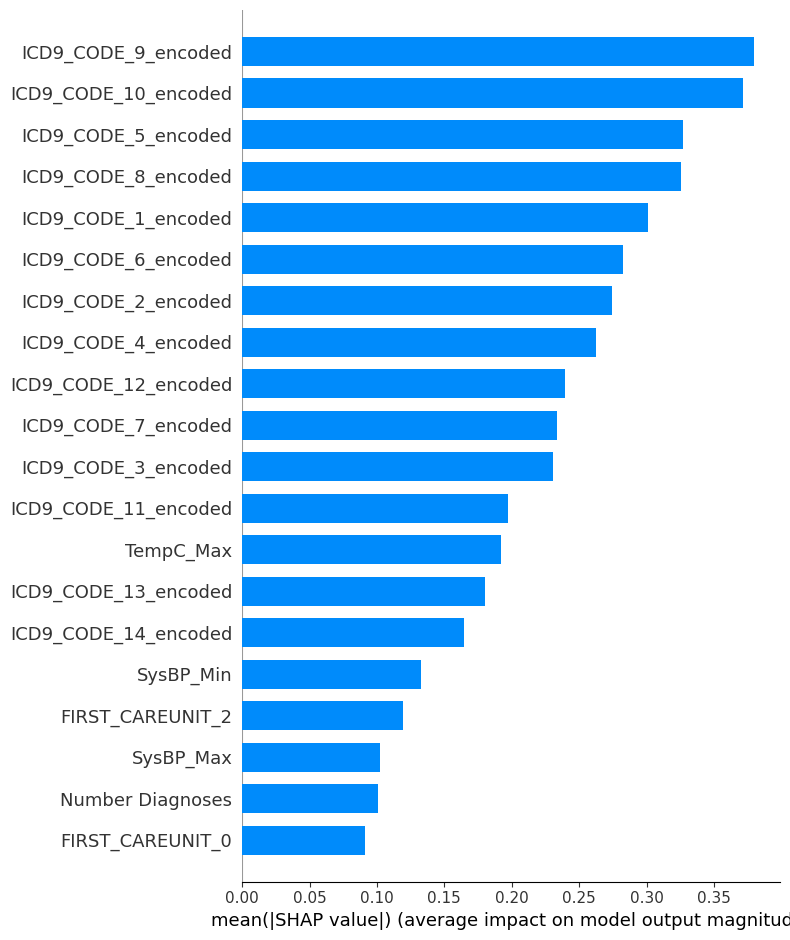

In [223]:
#Explainer on train data
explainer = shap.TreeExplainer(lgb_model_2) 
shap_values = explainer.shap_values(X_train_final)
shap.initjs()
shap.summary_plot(shap_values, X_train_final, plot_type="bar")

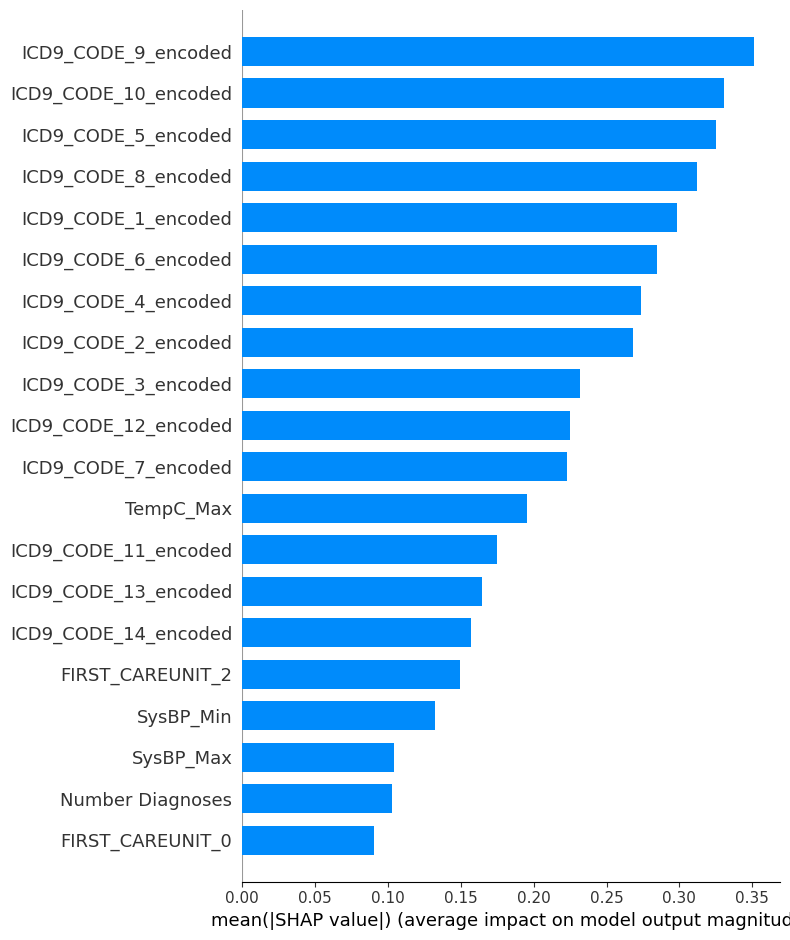

In [218]:
#explainer on test data
explainer_test = shap.TreeExplainer(lgb_model_2) 
shap_values = explainer.shap_values(X_target)
shap.initjs()
shap.summary_plot(shap_values, X_target, plot_type="bar")

We observe that the most influencing features are approximately the same both for Training and Test Data and are ranked very similarly. We observe how the ICD9 encoded features are the ones at the top of the ranking which seems logical since these variables are target encoded with the outcome variable 'LOS'.

Now we check how different it is to most important features.

In [225]:
def feature_imp(coef, names):
    imp = coef
    indexes = np.argsort(imp)[-20:]
    indexes = list(indexes)
    
    plt.barh(range(len(indexes)), imp[indexes], align='center')
    plt.yticks(range(len(indexes)), [names[i] for i in indexes])
    plt.show()
    
    return indexes

In [226]:
features_d = X_train_final.columns

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007246 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 9800
[LightGBM] [Info] Number of data points in the train set: 20885, number of used features: 61
[LightGBM] [Info] Start training from score 3.701046
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warnin

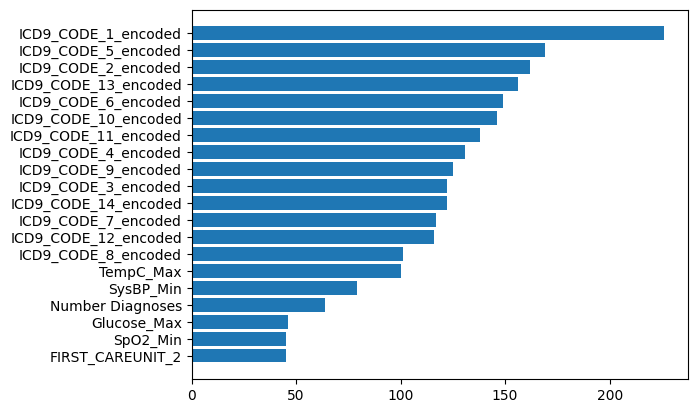

In [227]:
xgb_opt = lgb_model_2.fit(X_train_final, y_train_final)
feat_indexes_xgb = feature_imp(abs(xgb_opt.feature_importances_), features_d)

We see that even if in feature importance we still have all the ICD9 encoded features within the 20 most important features, the ranking is quite different to the one we obtained in SHAP both in train and test. Regarding vital signs and other categorical variables, both models include approximately the same (TempC Max, Number Diagnoses, SySBPMin and Careunit although feature importance also places Sp02 and Glucose).

Now we focus on local explainability using one single observation of the model. 

In [241]:
#Expected output of the model across all observations
explainer.expected_value

3.7010455594005958

In [250]:
# Plot the explanation of one observation
mytarget = 1

shap.initjs() ## needed to be added in each cell to get the plot to work

shap.force_plot(explainer.expected_value, shap_values[mytarget,:], X_target.iloc[mytarget,:])

In [251]:
# Plot the explanation of one observation
mytarget = 2

shap.initjs() ## needed to be added in each cell to get the plot to work

shap.force_plot(explainer.expected_value, shap_values[mytarget,:], X_target.iloc[mytarget,:])

Here we observe which are the most influencing features according to SHAP for the prediction of LOS for this observation. We see for observation 1 and 2 which would be the value given by the explainer SHAP. We see how observation 2 is closer to the "average" value of SHAP explainer across all observations (3,70) and we see how it has "higher" and "lower" influencing features offseting each other while for observation 1, expected to be much smaller, it has more features pushing to the "lower" side.

Overall we can see how in both cases the features that are explaining the most the deviation from the expected average of the model are the ICD9 encoded variables.

In [253]:
X_target.iloc[mytarget,:]

HeartRate_Min           1.947368
HeartRate_Max           1.035714
HeartRate_Mean          1.607567
SysBP_Min               0.150000
SysBP_Max              -0.366667
                          ...   
ICD9_CODE_10_encoded    0.356119
ICD9_CODE_11_encoded    0.219569
ICD9_CODE_12_encoded    0.540905
ICD9_CODE_13_encoded   -0.587031
ICD9_CODE_14_encoded   -0.417095
Name: 2, Length: 61, dtype: float64

In [254]:
predictions_lgb_2[2]

3.711528174951063

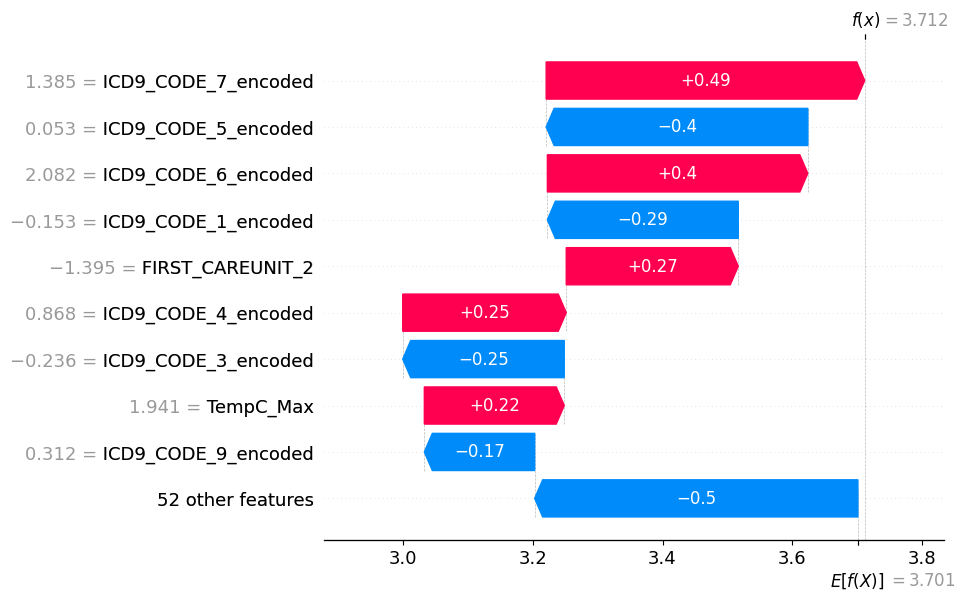

In [257]:
shap.plots.waterfall(explainer(X_target)[mytarget])

In this graph, we have another visual way to see the impact of each feature on the prediction according to shap. For example, the value of ICD9_7 of this observation contributes positively in 0.49 more units in the 'LOS' with respect to the average explainer value of shap (3.70)